# Extracción de Key Frames usando Clustering de Video (SIN PCA)

Este notebook implementa el método **KVS (K-means clustering-based Video Summarization)** descrito en el artículo:

**"Static Video Summarization Using Transfer Learning and Clustering"**  
*Shamal Kashid, Lalit K. Awasthi, Krishan Berwal, Parul Saini*

## Método Implementado (según el artículo):

1. **Extracción de Features con Dual-CNN**: GoogleNet + ResNet-50 (fusionados)
2. **K-Means Clustering**: Agrupa frames usando Euclidean distance
3. **Optimización con Silhouette Score**: Determina el número óptimo de clusters
4. **Selección de Keyframes**: Frame con **mayor disimilitud** al centroide (no el más cercano)

**Características del método del artículo:**
- Usa **Euclidean distance** como métrica de similitud
- **Silhouette Score** para optimizar número de clusters
- Selección de keyframes: frame con **mayor disimilitud** al centroide de cada cluster
- Métricas de evaluación: Precision, Recall, F-Measure

**Nota:** Este notebook asume que ya se han ejecutado los pasos 1, 2 y 3 del pipeline original:
- Paso 1: Filtrado de fondos uniformes
- Paso 2: Filtrado SSIM
- Paso 3: Extracción de features con ResNet50

**⚠️ IMPORTANTE:** Este notebook es idéntico al original pero **SIN usar PCA** para comparar resultados. Los features se usan directamente sin reducción de dimensionalidad.


In [1]:
# Configuración inicial
import sys
import os
from pathlib import Path
import pickle
import json
from datetime import datetime

# Configurar paths
project_root = Path("/Users/andrestrepo/Documents/repos_personal/proyecto-vision-computador")
sys.path.insert(0, str(project_root))
sys.path.insert(0, str(project_root / "src"))

# Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# Configuración
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")


In [2]:
# Importar módulos del pipeline
from src.app.utils.frame_filter import FrameFilter
from src.app.utils.preprocessor import DataPreprocessor
from src.app.utils.feature_extractor import FeatureExtractor
from src.app.utils.keyframe_selector import KeyFrameSelector
from src.app.utils.categorizer import FrameCategorizer
from src.app.utils.evaluator import PipelineEvaluator
from src.app.utils.dataset_builder import DatasetBuilder

# Imports para K-Means según el artículo
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.spatial.distance import cdist


## Paso 1: Cargar Datos Guardados

Cargamos los datos desde archivos guardados usando el mismo paso del notebook original:
- Dataset filtrado (después de SSIM)
- Features extraídos por video con ResNet50
- Metadatos de videos


In [3]:
# Configuración de paths
OUTPUT_DATASET_FILTRADO = "datasets/df_videos_frames_filtrados_v2.csv"
MODEL_NAME = 'resnet50'  # Debe coincidir con el modelo usado en el paso 3
FEATURES_DIR = f"features_{MODEL_NAME}"

# Inicializar preprocessor
preprocessor = DataPreprocessor(base_path=None)

# Cargar dataset filtrado
print("📂 Cargando dataset filtrado...")
df_preprocessed = preprocessor.load_dataset(
    csv_path=OUTPUT_DATASET_FILTRADO,
    frame_paths_col='frame_paths'
)

# Aplicar mapeo de canales si es necesario
channel_mapping = {
    'ARENA ALFA ': 'ARENA ALFA',
    'Bitcoin hoy ｜ Esteban Perez Trader': 'Bitcoin hoy',
    'Bolsas hoy ｜ Esteban Pérez Inversor': 'Bolsas hoy'
}

if 'channel' in df_preprocessed.columns:
    df_preprocessed['channel_name'] = df_preprocessed['channel'].replace(channel_mapping)

# Validar dataset
print("Validando rutas de frames...")
df_preprocessed = preprocessor.validate_dataset(
    df_preprocessed,
    frame_paths_col='frame_paths'
)

print(f"\n✅ Dataset cargado: {len(df_preprocessed)} videos")
print(f"   Total de frames: {df_preprocessed['n_frames_filtrado'].sum():,}")
print(f"   Canales únicos: {df_preprocessed['channel_name'].nunique()}")
print(f"   Canales: {', '.join(df_preprocessed['channel_name'].unique())}")


📂 Cargando dataset filtrado...
Cargando dataset desde datasets/df_videos_frames_filtrados_v2.csv...
Dataset cargado: 1133 videos
Validando rutas de frames...
Validando rutas de frames...
Videos con frames válidos: 1133

✅ Dataset cargado: 1133 videos
   Total de frames: 253,399
   Canales únicos: 3
   Canales: Bitcoin hoy, ARENA ALFA, Bolsas hoy


In [4]:
# Cargar features y datos de videos
import ast

# Inicializar extractor para cargar features
device = 'cuda' if __import__('torch').cuda.is_available() else 'cpu'
feature_extractor = FeatureExtractor(model_name=MODEL_NAME, device=device, batch_size=32)

print(f"📦 Cargando features desde {FEATURES_DIR}...")
print(f"   Usando dispositivo: {device}")
print(f"   Modelo: {MODEL_NAME.upper()}")

# Reconstruir datos desde archivos guardados
all_features = {}
all_frame_paths = {}
all_video_data = []

for idx, row in tqdm(df_preprocessed.iterrows(), total=len(df_preprocessed), desc="Cargando datos"):
    video_id = row['video_id']
    frame_paths = row['frame_paths']
    
    if not frame_paths or len(frame_paths) == 0:
        continue
    
    # Preparar datos del video
    video_data = preprocessor.prepare_video_data(row)
    all_video_data.append(video_data)
    
    # Cargar features si existen
    features_path = os.path.join(FEATURES_DIR, f"{video_id}_features.pkl")
    
    if os.path.exists(features_path):
        features, valid_paths, metadata = feature_extractor.load_features(features_path)
        all_features[video_id] = features
        all_frame_paths[video_id] = valid_paths
    else:
        print(f"⚠️  Advertencia: Features no encontrados para video {video_id}")

print(f"\n✅ Datos cargados:")
print(f"   Videos: {len(all_video_data)}")
print(f"   Features cargados: {len(all_features)}")
print(f"   Frames con paths: {sum(len(p) for p in all_frame_paths.values()):,}")


Cargando RESNET50 en cpu...
Modelo RESNET50 cargado exitosamente
Dimensión de features: 2048
📦 Cargando features desde features_resnet50...
   Usando dispositivo: cpu
   Modelo: RESNET50


Cargando datos: 100%|██████████| 1133/1133 [00:10<00:00, 107.92it/s]


✅ Datos cargados:
   Videos: 1133
   Features cargados: 1133
   Frames con paths: 253,399


## Paso 2: Seleccionar Videos para Análisis

Seleccionamos algunos videos para aplicar el método KVS del artículo.


In [5]:
# Seleccionar videos para análisis
# Seleccionamos algunos videos para aplicar el método KVS
N_VIDEOS_TO_ANALYZE = 1133  # Número de videos a analizar

# Seleccionar videos aleatorios de diferentes canales
np.random.seed(42)
selected_videos = []

# Agrupar por canal
from collections import defaultdict
videos_by_channel = defaultdict(list)
for video_data in all_video_data:
    channel_name = video_data['channel_name']
    videos_by_channel[channel_name].append(video_data)

# Seleccionar videos aleatorios de todos los canales
# Primero, mezclar todos los videos
all_videos_shuffled = all_video_data.copy()
np.random.shuffle(all_videos_shuffled)

# Seleccionar hasta N_VIDEOS_TO_ANALYZE videos
selected_videos = all_videos_shuffled[:N_VIDEOS_TO_ANALYZE]

# Opcional: Si quieres mantener balance entre canales, usa esta lógica alternativa:
# Calcular cuántos videos por canal necesitamos aproximadamente
# n_channels = len(videos_by_channel)
# videos_per_channel = max(1, N_VIDEOS_TO_ANALYZE // n_channels)
# 
# for channel_name, channel_videos in videos_by_channel.items():
#     n_select = min(videos_per_channel, len(channel_videos))
#     if n_select > 0:
#         selected = np.random.choice(len(channel_videos), size=n_select, replace=False)
#         selected_videos.extend([channel_videos[i] for i in selected])
# 
# # Si aún no tenemos suficientes, agregar más aleatoriamente
# if len(selected_videos) < N_VIDEOS_TO_ANALYZE:
#     remaining = [v for v in all_video_data if v not in selected_videos]
#     np.random.shuffle(remaining)
#     needed = N_VIDEOS_TO_ANALYZE - len(selected_videos)
#     selected_videos.extend(remaining[:needed])

print(f"📹 Videos seleccionados para análisis: {len(selected_videos)}")
for video_data in selected_videos:
    video_id = video_data['video_id']
    channel_name = video_data['channel_name']
    n_frames = len(all_frame_paths.get(video_id, []))
    print(f"   - {video_id} ({channel_name}): {n_frames} frames")


📹 Videos seleccionados para análisis: 1133
   - wEO7-DD0rT4 (ARENA ALFA): 52 frames
   - AKeuY_q3Go0 (Bolsas hoy): 379 frames
   - 9o8q7n3fjwU (Bitcoin hoy): 489 frames
   - p6DM5BbdR8I (Bitcoin hoy): 125 frames
   - -nkMLjuw5BM (Bitcoin hoy): 132 frames
   - a5-0k5Qm914 (Bitcoin hoy): 307 frames
   - ZNfVAYMuotI (Bitcoin hoy): 217 frames
   - jsd5TU9SF0g (Bitcoin hoy): 226 frames
   - gnwBV2g76lg (Bolsas hoy): 326 frames
   - II3SlwDVxqo (ARENA ALFA): 23 frames
   - JU2SYzBmKgM (ARENA ALFA): 66 frames
   - EvlF9G0tr1Y (Bitcoin hoy): 227 frames
   - S9e6NgHTEKA (Bitcoin hoy): 260 frames
   - R-yEmBc6uqM (ARENA ALFA): 61 frames
   - jOVNUexMu4c (Bolsas hoy): 185 frames
   - nZNWNbUuWik (Bolsas hoy): 109 frames
   - sFPnEwsEsHk (Bitcoin hoy): 200 frames
   - oF8r4FJF5q0 (Bolsas hoy): 307 frames
   - uoTJm3Ete_A (Bolsas hoy): 175 frames
   - Zu6V4G5DJtE (Bitcoin hoy): 263 frames
   - _Uc1RSvAnkw (Bitcoin hoy): 471 frames
   - IwxG67QBmGE (Bitcoin hoy): 219 frames
   - zFo4R9U_l24 (Bolsas 

## Paso 3: Implementación del Método KVS del Artículo

Implementamos el método K-Means clustering según el artículo.


In [6]:
# Configuración según el artículo
MIN_CLUSTERS = 5
MAX_CLUSTERS = 50
MIN_KEYFRAME_RATIO = 0.05  # 5%
MAX_KEYFRAME_RATIO = 0.25  # 25%
# El artículo usa Euclidean distance (no cosine)
DISTANCE_METRIC = 'euclidean'  # Según el artículo: "utilizing euclidean distance as the measure of similarity"

print(f"⚙️  Configuración del método KVS (según el artículo):")
print(f"   Min clusters: {MIN_CLUSTERS}")
print(f"   Max clusters: {MAX_CLUSTERS}")
print(f"   Min ratio keyframes: {MIN_KEYFRAME_RATIO*100:.1f}%")
print(f"   Max ratio keyframes: {MAX_KEYFRAME_RATIO*100:.1f}%")
print(f"   Métrica de distancia: {DISTANCE_METRIC} (según el artículo)")
print(f"   Optimización: Silhouette Score (maximizar)")
print(f"   Selección keyframes: Frame con MAYOR disimilitud al centroide")


⚙️  Configuración del método KVS (según el artículo):
   Min clusters: 5
   Max clusters: 50
   Min ratio keyframes: 5.0%
   Max ratio keyframes: 25.0%
   Métrica de distancia: euclidean (según el artículo)
   Optimización: Silhouette Score (maximizar)
   Selección keyframes: Frame con MAYOR disimilitud al centroide


## Mejoras para Aumentar el Silhouette Score

Estrategias para mejorar el silhouette score manteniendo el método del artículo:
1. ~~**Reducción de dimensionalidad (PCA)**: Reduce la dimensionalidad de los features~~ **NO SE USA PCA EN ESTE NOTEBOOK**
2. **Normalización de features**: Aunque el artículo no lo menciona, puede ayudar
3. **Aumentar n_init**: Más inicializaciones para encontrar mejores clusters
4. **Ajustar rango de clusters**: Optimizar MIN_CLUSTERS y MAX_CLUSTERS
5. **Filtrado de features**: Eliminar features con baja varianza

**⚠️ NOTA:** Este notebook NO usa PCA para comparar resultados con la versión que sí lo usa.


In [7]:
# Mejoras para aumentar el Silhouette Score (optimizado para embeddings)
# NOTA: Este notebook NO usa PCA para comparar resultados

# Configuración de mejoras (optimizado para embeddings)
USE_PCA = False  # NO usar PCA - comparar con versión que sí lo usa
PCA_COMPONENTS = 0.95  # No se usa (solo para referencia)
N_INIT_INCREASED = 50  # Aumentar número de inicializaciones (default: 10)
MAX_ITER_INCREASED = 500  # Aumentar iteraciones máximas (default: 300)

def preprocess_embeddings_for_clustering(embeddings, use_pca=USE_PCA, 
                                         pca_components=PCA_COMPONENTS):
    """
    Preprocesa embeddings para mejorar el clustering.
    
    NOTA: Los embeddings son representaciones vectoriales optimizadas que capturan
    información semántica. En este notebook NO se usa PCA para comparar resultados.
    
    Args:
        embeddings: Array numpy con embeddings (n_frames, n_features)
        use_pca: Si True, aplica PCA para reducir dimensionalidad (NO SE USA EN ESTE NOTEBOOK)
        pca_components: Número de componentes o proporción de varianza a mantener (NO SE USA)
    
    Returns:
        embeddings procesados y objeto PCA (None en este notebook)
    """
    processed_embeddings = embeddings.copy()
    pca_model = None
    
    # NO se aplica PCA en este notebook - usar features originales directamente
    # Esto permite comparar resultados con la versión que sí usa PCA
    if use_pca:
        print(f"   ⚠️  Advertencia: PCA está deshabilitado en este notebook")
        print(f"   📊 Usando features originales: {embeddings.shape[1]} dimensiones")
    
    return processed_embeddings, pca_model

def calculate_optimal_clusters_improved(embeddings, min_k=MIN_CLUSTERS, max_k=MAX_CLUSTERS, 
                                       min_ratio=MIN_KEYFRAME_RATIO, max_ratio=MAX_KEYFRAME_RATIO,
                                       n_init=N_INIT_INCREASED, max_iter=MAX_ITER_INCREASED):
    """
    Calcula el número óptimo de clusters con mejoras para aumentar silhouette score.
    
    Mejoras específicas para embeddings:
    - Más inicializaciones (n_init) para encontrar mejores clusters
    - Más iteraciones (max_iter) para mejor convergencia
    - Búsqueda más exhaustiva del número óptimo de clusters
    """
    n_frames = len(embeddings)
    
    # Calcular límites basados en ratios
    min_k_from_ratio = max(1, int(n_frames * min_ratio))
    max_k_from_ratio = min(max_k, int(n_frames * max_ratio))
    
    min_k = max(min_k, min_k_from_ratio)
    max_k = min(max_k, max_k_from_ratio, n_frames - 1)
    
    if min_k >= max_k:
        return min_k, [], []
    
    # Calcular Silhouette Score para diferentes k con mejoras
    silhouettes = []
    k_range = range(min_k, max_k + 1)
    
    print(f"   🔍 Buscando k óptimo en rango [{min_k}, {max_k}] con {n_init} inicializaciones...")
    
    for k in k_range:
        # Usar más inicializaciones y más iteraciones para embeddings
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=n_init, max_iter=max_iter)
        labels = kmeans.fit_predict(embeddings)
        
        # Calcular silhouette score
        try:
            sil_score = silhouette_score(embeddings, labels)
            silhouettes.append(sil_score)
        except Exception as e:
            silhouettes.append(0)
    
    # Encontrar k óptimo: "select the SS that is closest to 1"
    optimal_k = min_k + np.argmax(silhouettes)
    best_silhouette = max(silhouettes)
    
    print(f"   ✅ k óptimo: {optimal_k} (Silhouette Score: {best_silhouette:.4f})")
    
    return optimal_k, silhouettes, list(k_range)

def extract_keyframes_kvs_improved(embeddings, frame_paths, n_clusters=None):
    """
    Versión mejorada de extract_keyframes_kvs optimizada para embeddings.
    
    Mejoras específicas para embeddings:
    1. NO se usa PCA - features originales directamente (para comparar con versión con PCA)
    2. Más inicializaciones y iteraciones en K-Means
    3. Búsqueda más exhaustiva del número óptimo de clusters
    
    NOTA: Este notebook NO usa PCA para comparar resultados con la versión que sí lo usa.
    """
    if len(embeddings) == 0:
        return [], np.array([]), None, {}
    
    print(f"   🔧 Preprocesando embeddings (shape: {embeddings.shape})...")
    print(f"   ⚠️  NO se usa PCA - usando features originales directamente")
    
    # Preprocesar embeddings (NO se usa PCA en este notebook)
    processed_embeddings, pca_model = preprocess_embeddings_for_clustering(
        embeddings,
        use_pca=USE_PCA,
        pca_components=PCA_COMPONENTS
    )
    
    # Calcular número óptimo de clusters usando Silhouette Score (versión mejorada)
    if n_clusters is None:
        n_clusters, _, _ = calculate_optimal_clusters_improved(
            processed_embeddings,
            n_init=N_INIT_INCREASED,
            max_iter=MAX_ITER_INCREASED
        )
    
    # Asegurar que n_clusters no exceda el número de frames
    n_clusters = min(n_clusters, len(processed_embeddings))
    
    # Aplicar K-Means con mejoras (más inicializaciones e iteraciones)
    print(f"   🔧 Aplicando K-Means con {n_clusters} clusters ({N_INIT_INCREASED} inicializaciones, {MAX_ITER_INCREASED} iteraciones)...")
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=N_INIT_INCREASED, max_iter=MAX_ITER_INCREASED)
    labels = kmeans.fit_predict(processed_embeddings)
    
    # Seleccionar key frames según el artículo
    keyframes = []
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(labels == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
        
        cluster_embeddings = processed_embeddings[cluster_indices]
        centroid = kmeans.cluster_centers_[cluster_id]
        
        # Calcular distancias al centroide usando Euclidean distance
        distances = cdist(cluster_embeddings, centroid.reshape(1, -1), metric='euclidean').flatten()
        
        # Frame con MAYOR disimilitud al centroide (según el artículo)
        farthest_idx = np.argmax(distances)
        frame_idx = cluster_indices[farthest_idx]
        keyframes.append(frame_paths[frame_idx])
    
    # Calcular silhouette score
    sil_score = silhouette_score(processed_embeddings, labels)
    
    # Estadísticas
    stats = {
        'n_clusters': n_clusters,
        'n_keyframes': len(keyframes),
        'n_frames': len(frame_paths),
        'reduction_percentage': (1 - len(keyframes) / len(frame_paths)) * 100 if len(frame_paths) > 0 else 0,
        'silhouette_score': sil_score,
        'method': 'KVS Improved (SIN PCA - para comparación)'
    }
    
    return keyframes, labels, kmeans, stats

print("✅ Funciones mejoradas definidas (SIN PCA - para comparación)")
print(f"   PCA: {USE_PCA} (NO se usa PCA en este notebook)")
print(f"   n_init: {N_INIT_INCREASED}, max_iter: {MAX_ITER_INCREASED}")


✅ Funciones mejoradas definidas (SIN PCA - para comparación)
   PCA: False (NO se usa PCA en este notebook)
   n_init: 50, max_iter: 500


In [8]:
def calculate_optimal_clusters(features, min_k=MIN_CLUSTERS, max_k=MAX_CLUSTERS, 
                                min_ratio=MIN_KEYFRAME_RATIO, max_ratio=MAX_KEYFRAME_RATIO):
    """
    Calcula el número óptimo de clusters usando Silhouette Score según el artículo.
    
    El artículo dice: "The silhouette score (SS) determines the optimal number of clusters"
    "To determine the optimal number of clusters for each video, we select the SS that is closest to 1"
    """
    n_frames = len(features)
    
    # Calcular límites basados en ratios
    min_k_from_ratio = max(1, int(n_frames * min_ratio))
    max_k_from_ratio = min(max_k, int(n_frames * max_ratio))
    
    min_k = max(min_k, min_k_from_ratio)
    max_k = min(max_k, max_k_from_ratio, n_frames - 1)
    
    if min_k >= max_k:
        return min_k, [], []
    
    # NO normalizar features - el artículo usa Euclidean distance directamente
    # El artículo no menciona normalización
    
    # Calcular Silhouette Score para diferentes k
    silhouettes = []
    k_range = range(min_k, max_k + 1)
    
    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        labels = kmeans.fit_predict(features)
        silhouettes.append(silhouette_score(features, labels))
    
    # Encontrar k óptimo: "select the SS that is closest to 1"
    optimal_k = min_k + np.argmax(silhouettes)
    
    return optimal_k, silhouettes, list(k_range)


In [9]:
def extract_keyframes_kvs(features, frame_paths, n_clusters=None):
    """
    Extrae key frames usando K-Means clustering según el método KVS del artículo.
    
    Según el artículo:
    1. Usa K-Means con Euclidean distance
    2. Silhouette Score para optimizar número de clusters
    3. Selecciona frame con MAYOR disimilitud al centroide (no el más cercano)
    
    "The frame exhibiting the highest dissimilarity is then selected as the representative"
    """
    if len(features) == 0:
        return [], np.array([]), None, {}
    
    # NO normalizar - el artículo usa Euclidean distance directamente
    # El artículo no menciona normalización de features
    
    # Calcular número óptimo de clusters usando Silhouette Score
    if n_clusters is None:
        n_clusters, _, _ = calculate_optimal_clusters(features)
    
    # Asegurar que n_clusters no exceda el número de frames
    n_clusters = min(n_clusters, len(features))
    
    # Aplicar K-Means con Euclidean distance (según el artículo)
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
    labels = kmeans.fit_predict(features)
    
    # Seleccionar key frames según el artículo:
    # "The frame exhibiting the highest dissimilarity is then selected"
    keyframes = []
    for cluster_id in range(n_clusters):
        cluster_indices = np.where(labels == cluster_id)[0]
        if len(cluster_indices) == 0:
            continue
        
        cluster_features = features[cluster_indices]
        centroid = kmeans.cluster_centers_[cluster_id]
        
        # Calcular distancias al centroide usando Euclidean distance
        distances = cdist(cluster_features, centroid.reshape(1, -1), metric='euclidean').flatten()
        
        # Frame con MAYOR disimilitud al centroide (según el artículo)
        farthest_idx = np.argmax(distances)
        frame_idx = cluster_indices[farthest_idx]
        keyframes.append(frame_paths[frame_idx])
    
    # Estadísticas
    stats = {
        'n_clusters': n_clusters,
        'n_keyframes': len(keyframes),
        'n_frames': len(frame_paths),
        'reduction_percentage': (1 - len(keyframes) / len(frame_paths)) * 100 if len(frame_paths) > 0 else 0,
        'silhouette_score': silhouette_score(features, labels),
        'method': 'KVS (K-Means clustering-based Video Summarization)'
    }
    
    return keyframes, labels, kmeans, stats




## Paso 4: Aplicar Método KVS a Videos Seleccionados

Aplicamos el método KVS del artículo a los videos seleccionados.


In [10]:
# Aplicar método KVS del artículo a los videos seleccionados
import time
from datetime import timedelta

results = []
results_detailed = []  # Guardar resultados detallados con keyframes y labels

print("🚀 Aplicando método KVS del artículo a videos seleccionados...")
print("=" * 80)

# Iniciar medición de tiempo
start_time = time.time()

# Procesar videos con tqdm que muestra tiempo transcurrido
pbar = tqdm(selected_videos, desc="Procesando videos", unit="video")
for video_data in pbar:
    video_id = video_data['video_id']
    channel_name = video_data['channel_name']
    
    if video_id not in all_features:
        continue
    
    features = all_features[video_id]
    frame_paths = all_frame_paths[video_id]
    
    # Actualizar descripción de la barra de progreso con tiempo transcurrido
    elapsed_time = time.time() - start_time
    elapsed_str = str(timedelta(seconds=int(elapsed_time)))
    pbar.set_description(f"Procesando videos (⏱️ {elapsed_str})")
    
    # Aplicar método KVS del artículo
    try:
        keyframes_kvs, labels_kvs, model_kvs, stats_kvs = extract_keyframes_kvs(
            features, frame_paths
        )
        
        # Crear diccionario de keyframes (frame_path -> True si es keyframe)
        keyframe_set = set(keyframes_kvs)
        is_keyframe = [fp in keyframe_set for fp in frame_paths]
        
        results.append({
            'video_id': video_id,
            'channel_name': channel_name,
            'n_frames': len(frame_paths),
            **stats_kvs
        })
        
        # Guardar resultados detallados para visualización
        results_detailed.append({
            'video_id': video_id,
            'channel_name': channel_name,
            'frame_paths': frame_paths,
            'keyframes': keyframes_kvs,
            'labels': labels_kvs,
            'is_keyframe': is_keyframe,
            'n_frames': len(frame_paths),
            'n_keyframes': stats_kvs['n_keyframes']
        })
        
        # Usar tqdm.write para que no se acumulen los mensajes
        tqdm.write(f"✅ {video_id[:12]}... ({channel_name}): {stats_kvs['n_keyframes']} keyframes de {len(frame_paths)} frames ({stats_kvs['reduction_percentage']:.1f}% reducción)")
    except Exception as e:
        tqdm.write(f"❌ Error en {video_id}: {e}")
        import traceback
        traceback.print_exc()

# Cerrar barra de progreso
pbar.close()

# Calcular tiempo total
total_time = time.time() - start_time
total_time_str = str(timedelta(seconds=int(total_time)))

print("\n" + "=" * 80)
print(f"✅ Procesamiento completado")
print(f"⏱️  Tiempo total: {total_time_str} ({total_time:.2f} segundos)")
print(f"📊 Videos procesados: {len(results)} de {len(selected_videos)}")
print("=" * 80)



Procesando videos (⏱️ 1:55:26):  89%|████████▉ | 1008/1133 [1:55:26<07:18,  3.51s/video]

✅ Is1w_FyiICE... (Bitcoin hoy): 42 keyframes de 180 frames (76.7% reducción)


Procesando videos (⏱️ 1:55:29):  89%|████████▉ | 1009/1133 [1:55:29<06:50,  3.31s/video]

✅ poIDTX5df5U... (Bitcoin hoy): 9 keyframes de 143 frames (93.7% reducción)


Procesando videos (⏱️ 1:55:42):  89%|████████▉ | 1010/1133 [1:55:42<12:34,  6.13s/video]

✅ 2V07uaYrjF8... (Bitcoin hoy): 37 keyframes de 371 frames (90.0% reducción)


Procesando videos (⏱️ 1:55:55):  89%|████████▉ | 1011/1133 [1:55:55<16:59,  8.36s/video]

✅ Rclcr59eT3w... (Bitcoin hoy): 21 keyframes de 421 frames (95.0% reducción)


Procesando videos (⏱️ 1:56:02):  89%|████████▉ | 1012/1133 [1:56:02<15:59,  7.93s/video]

✅ NgqKiCNIT80... (Bolsas hoy): 9 keyframes de 188 frames (95.2% reducción)


Procesando videos (⏱️ 1:56:06):  89%|████████▉ | 1013/1133 [1:56:06<13:10,  6.58s/video]

✅ C3W6XFhYUWM... (Bolsas hoy): 11 keyframes de 155 frames (92.9% reducción)


Procesando videos (⏱️ 1:56:13):  89%|████████▉ | 1014/1133 [1:56:13<13:15,  6.68s/video]

✅ NLFWM-Ma6N8... (Bitcoin hoy): 25 keyframes de 189 frames (86.8% reducción)


Procesando videos (⏱️ 1:56:27):  90%|████████▉ | 1015/1133 [1:56:27<17:48,  9.06s/video]

✅ bJTOHc8XHQI... (Bitcoin hoy): 32 keyframes de 515 frames (93.8% reducción)


Procesando videos (⏱️ 1:56:35):  90%|████████▉ | 1016/1133 [1:56:35<17:00,  8.72s/video]

✅ WQkHqZee-Wg... (Bolsas hoy): 45 keyframes de 232 frames (80.6% reducción)


Procesando videos (⏱️ 1:56:39):  90%|████████▉ | 1017/1133 [1:56:39<13:50,  7.16s/video]

✅ E38DBzX9j4A... (Bitcoin hoy): 33 keyframes de 154 frames (78.6% reducción)


Procesando videos (⏱️ 1:56:39):  90%|████████▉ | 1018/1133 [1:56:39<10:05,  5.27s/video]

✅ pz6kahS_qHo... (Bitcoin hoy): 6 keyframes de 93 frames (93.5% reducción)


Procesando videos (⏱️ 1:56:44):  90%|████████▉ | 1019/1133 [1:56:44<09:49,  5.17s/video]

✅ GCM6E37rLHk... (Bitcoin hoy): 8 keyframes de 177 frames (95.5% reducción)


Procesando videos (⏱️ 1:56:59):  90%|█████████ | 1020/1133 [1:56:59<15:02,  7.98s/video]Traceback (most recent call last):
  File "/var/folders/0z/3s22b27525jc3bm0m923h36h3wg489/T/ipykernel_90250/456322753.py", line 33, in <module>
    keyframes_kvs, labels_kvs, model_kvs, stats_kvs = extract_keyframes_kvs(
                                                      ^^^^^^^^^^^^^^^^^^^^^^
  File "/var/folders/0z/3s22b27525jc3bm0m923h36h3wg489/T/ipykernel_90250/3259005088.py", line 54, in extract_keyframes_kvs
    'silhouette_score': silhouette_score(features, labels),
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/andrestrepo/Documents/repos_personal/proyecto-vision-computador/.venv/lib/python3.12/site-packages/sklearn/utils/_param_validation.py", line 218, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "/Users/andrestrepo/Documents/repos_personal/proyecto-vision-computador/.venv/lib/python3.12/site-packages/sklearn/metrics/clus

✅ dJh8urRbpto... (Bitcoin hoy): 30 keyframes de 531 frames (94.4% reducción)
❌ Error en 6uGldYqdh9Q: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


Procesando videos (⏱️ 1:57:08):  90%|█████████ | 1022/1133 [1:57:08<11:40,  6.31s/video]

✅ spDLvcVQLxs... (Bitcoin hoy): 28 keyframes de 211 frames (86.7% reducción)


Procesando videos (⏱️ 1:57:19):  90%|█████████ | 1023/1133 [1:57:19<13:51,  7.56s/video]

✅ DASa-Hxkp7M... (Bitcoin hoy): 47 keyframes de 319 frames (85.3% reducción)


Procesando videos (⏱️ 1:57:31):  90%|█████████ | 1024/1133 [1:57:31<15:52,  8.74s/video]

✅ yk0J5ckOGNw... (Bitcoin hoy): 24 keyframes de 356 frames (93.3% reducción)


Procesando videos (⏱️ 1:57:41):  90%|█████████ | 1025/1133 [1:57:41<16:11,  9.00s/video]

✅ sOrPaHQjO3M... (Bolsas hoy): 13 keyframes de 268 frames (95.1% reducción)


Procesando videos (⏱️ 1:57:50):  91%|█████████ | 1026/1133 [1:57:50<16:20,  9.16s/video]

✅ ee1mXfmB4JQ... (Bitcoin hoy): 21 keyframes de 285 frames (92.6% reducción)


Procesando videos (⏱️ 1:58:05):  91%|█████████ | 1027/1133 [1:58:05<18:52, 10.68s/video]

✅ CYpTblHx-w4... (Bitcoin hoy): 49 keyframes de 510 frames (90.4% reducción)


Procesando videos (⏱️ 1:58:05):  91%|█████████ | 1028/1133 [1:58:05<13:24,  7.67s/video]

✅ lzURVzUe7CQ... (ARENA ALFA): 13 keyframes de 56 frames (76.8% reducción)
✅ kG30gkmkEZM... (ARENA ALFA): 5 keyframes de 9 frames (44.4% reducción)


Procesando videos (⏱️ 1:58:13):  91%|█████████ | 1030/1133 [1:58:13<10:20,  6.03s/video]

✅ wvVHlqePk2M... (Bitcoin hoy): 13 keyframes de 234 frames (94.4% reducción)


Procesando videos (⏱️ 1:58:14):  91%|█████████ | 1031/1133 [1:58:14<07:55,  4.66s/video]

✅ jaFrN80Yu5o... (ARENA ALFA): 7 keyframes de 65 frames (89.2% reducción)


Procesando videos (⏱️ 1:58:16):  91%|█████████ | 1032/1133 [1:58:16<06:57,  4.13s/video]

✅ AGi_jdU2nCE... (Bolsas hoy): 6 keyframes de 138 frames (95.7% reducción)


Procesando videos (⏱️ 1:58:27):  91%|█████████ | 1033/1133 [1:58:27<10:03,  6.03s/video]

✅ 2JCBOS98QQs... (Bolsas hoy): 22 keyframes de 335 frames (93.4% reducción)


Procesando videos (⏱️ 1:58:34):  91%|█████████▏| 1034/1133 [1:58:34<10:17,  6.23s/video]

✅ DKnAJDDIL3Q... (Bitcoin hoy): 22 keyframes de 202 frames (89.1% reducción)


Procesando videos (⏱️ 1:58:44):  91%|█████████▏| 1035/1133 [1:58:44<11:43,  7.18s/video]

✅ 8b6p48FrqL4... (Bitcoin hoy): 18 keyframes de 297 frames (93.9% reducción)


Procesando videos (⏱️ 1:58:46):  91%|█████████▏| 1036/1133 [1:58:46<09:22,  5.80s/video]

✅ 6RIX-OIQqdA... (Bolsas hoy): 6 keyframes de 139 frames (95.7% reducción)


Procesando videos (⏱️ 1:58:53):  92%|█████████▏| 1038/1133 [1:58:53<06:53,  4.35s/video]

✅ zuUsAghtWkM... (Bitcoin hoy): 12 keyframes de 201 frames (94.0% reducción)
✅ jx5thkYM2uI... (Bitcoin hoy): 7 keyframes de 50 frames (86.0% reducción)


Procesando videos (⏱️ 1:58:58):  92%|█████████▏| 1039/1133 [1:58:58<06:51,  4.38s/video]

✅ KMTrI3_AKsk... (Bitcoin hoy): 41 keyframes de 171 frames (76.0% reducción)


Procesando videos (⏱️ 1:58:58):  92%|█████████▏| 1040/1133 [1:58:58<04:57,  3.19s/video]

✅ qcKNtNfQlqY... (ARENA ALFA): 15 keyframes de 65 frames (76.9% reducción)


Procesando videos (⏱️ 1:59:05):  92%|█████████▏| 1041/1133 [1:59:05<06:33,  4.28s/video]

✅ 09oo01IEvWo... (Bitcoin hoy): 10 keyframes de 199 frames (95.0% reducción)


Procesando videos (⏱️ 1:59:14):  92%|█████████▏| 1042/1133 [1:59:14<08:40,  5.72s/video]

✅ zf03y_Iv3bc... (Bitcoin hoy): 42 keyframes de 275 frames (84.7% reducción)


Procesando videos (⏱️ 1:59:21):  92%|█████████▏| 1043/1133 [1:59:21<09:18,  6.21s/video]

✅ CPZCc6yTyx0... (Bolsas hoy): 36 keyframes de 216 frames (83.3% reducción)


Procesando videos (⏱️ 1:59:22):  92%|█████████▏| 1044/1133 [1:59:22<06:37,  4.47s/video]

✅ 98c0LtZPoNs... (ARENA ALFA): 14 keyframes de 68 frames (79.4% reducción)


Procesando videos (⏱️ 1:59:36):  92%|█████████▏| 1045/1133 [1:59:36<10:40,  7.28s/video]

✅ OBhDkej5cxs... (Bitcoin hoy): 24 keyframes de 435 frames (94.5% reducción)


Procesando videos (⏱️ 1:59:45):  92%|█████████▏| 1046/1133 [1:59:45<11:26,  7.89s/video]

✅ 2SCK02B_Mak... (Bitcoin hoy): 13 keyframes de 205 frames (93.7% reducción)


Procesando videos (⏱️ 1:59:56):  92%|█████████▏| 1047/1133 [1:59:56<12:43,  8.88s/video]

✅ LXakgCdI5EQ... (Bitcoin hoy): 31 keyframes de 245 frames (87.3% reducción)


Procesando videos (⏱️ 2:00:10):  92%|█████████▏| 1048/1133 [2:00:10<14:53, 10.51s/video]

✅ nFI6V6fxZ3k... (Bolsas hoy): 18 keyframes de 378 frames (95.2% reducción)


Procesando videos (⏱️ 2:00:15):  93%|█████████▎| 1049/1133 [2:00:15<12:05,  8.63s/video]

✅ TaOWXoBSPNc... (Bitcoin hoy): 9 keyframes de 160 frames (94.4% reducción)


Procesando videos (⏱️ 2:00:27):  93%|█████████▎| 1050/1133 [2:00:27<13:36,  9.83s/video]

✅ 7TKDKPPb9Js... (Bitcoin hoy): 18 keyframes de 315 frames (94.3% reducción)


Procesando videos (⏱️ 2:00:36):  93%|█████████▎| 1051/1133 [2:00:36<13:06,  9.59s/video]

✅ RHtDE5w6DjI... (Bitcoin hoy): 22 keyframes de 287 frames (92.3% reducción)


Procesando videos (⏱️ 2:00:37):  93%|█████████▎| 1052/1133 [2:00:37<09:18,  6.90s/video]

✅ YYTIsbNA5t0... (Bitcoin hoy): 10 keyframes de 80 frames (87.5% reducción)


Procesando videos (⏱️ 2:00:37):  93%|█████████▎| 1053/1133 [2:00:37<06:39,  4.99s/video]

✅ 5vgvo9L3x5s... (Bitcoin hoy): 7 keyframes de 78 frames (91.0% reducción)


Procesando videos (⏱️ 2:00:47):  93%|█████████▎| 1054/1133 [2:00:47<08:23,  6.37s/video]

✅ SLMN811ZynE... (Bitcoin hoy): 17 keyframes de 305 frames (94.4% reducción)


Procesando videos (⏱️ 2:00:47):  93%|█████████▎| 1055/1133 [2:00:47<05:53,  4.54s/video]

✅ XgUjC-_nJX8... (Bitcoin hoy): 12 keyframes de 59 frames (79.7% reducción)


Procesando videos (⏱️ 2:00:59):  93%|█████████▎| 1056/1133 [2:00:59<08:39,  6.75s/video]

✅ 77hW2B9p_wk... (Bitcoin hoy): 26 keyframes de 375 frames (93.1% reducción)


Procesando videos (⏱️ 2:01:06):  93%|█████████▎| 1057/1133 [2:01:06<08:39,  6.84s/video]

✅ 5X4MM1C4Hq8... (Bitcoin hoy): 10 keyframes de 209 frames (95.2% reducción)


Procesando videos (⏱️ 2:01:11):  93%|█████████▎| 1058/1133 [2:01:11<07:44,  6.19s/video]

✅ lmXBypDjGLY... (Bitcoin hoy): 36 keyframes de 172 frames (79.1% reducción)


Procesando videos (⏱️ 2:01:20):  93%|█████████▎| 1059/1133 [2:01:20<08:45,  7.10s/video]

✅ jZwk451A774... (Bitcoin hoy): 14 keyframes de 292 frames (95.2% reducción)


Procesando videos (⏱️ 2:01:28):  94%|█████████▎| 1060/1133 [2:01:28<08:58,  7.38s/video]

✅ ChbguT3P_2g... (Bitcoin hoy): 47 keyframes de 218 frames (78.4% reducción)


Procesando videos (⏱️ 2:01:41):  94%|█████████▎| 1061/1133 [2:01:41<10:56,  9.12s/video]

✅ WUH1ucEwJ-4... (Bitcoin hoy): 49 keyframes de 445 frames (89.0% reducción)


Procesando videos (⏱️ 2:01:46):  94%|█████████▎| 1062/1133 [2:01:46<09:21,  7.90s/video]

✅ T82o2MsMQgE... (ARENA ALFA): 9 keyframes de 182 frames (95.1% reducción)


Procesando videos (⏱️ 2:01:56):  94%|█████████▍| 1064/1133 [2:01:56<06:48,  5.92s/video]

✅ OOOZvZrmf7s... (Bitcoin hoy): 22 keyframes de 293 frames (92.5% reducción)
✅ 3wLkSO-ZQCs... (ARENA ALFA): 6 keyframes de 51 frames (88.2% reducción)
✅ wVcOSu_JWpM... (ARENA ALFA): 5 keyframes de 16 frames (68.8% reducción)


Procesando videos (⏱️ 2:02:04):  94%|█████████▍| 1066/1133 [2:02:04<05:43,  5.13s/video]

✅ pVqx7d1q6eI... (Bitcoin hoy): 13 keyframes de 260 frames (95.0% reducción)


Procesando videos (⏱️ 2:02:19):  94%|█████████▍| 1067/1133 [2:02:19<08:11,  7.45s/video]

✅ bVw6X6ZF6Q0... (Bitcoin hoy): 49 keyframes de 475 frames (89.7% reducción)


Procesando videos (⏱️ 2:02:34):  94%|█████████▍| 1068/1133 [2:02:34<10:06,  9.34s/video]

✅ 9ux8EBTrWYA... (Bitcoin hoy): 27 keyframes de 555 frames (95.1% reducción)


Procesando videos (⏱️ 2:02:47):  94%|█████████▍| 1069/1133 [2:02:47<11:13, 10.53s/video]

✅ Abub2WNPffw... (Bolsas hoy): 36 keyframes de 418 frames (91.4% reducción)


Procesando videos (⏱️ 2:02:53):  94%|█████████▍| 1070/1133 [2:02:53<09:31,  9.07s/video]

✅ qARp7wLxI0k... (Bitcoin hoy): 9 keyframes de 173 frames (94.8% reducción)


Procesando videos (⏱️ 2:02:54):  95%|█████████▍| 1072/1133 [2:02:54<04:54,  4.83s/video]

✅ 0t-PD06mX4o... (ARENA ALFA): 9 keyframes de 95 frames (90.5% reducción)
✅ y8DV5XfgXi0... (Bitcoin hoy): 10 keyframes de 40 frames (75.0% reducción)


Procesando videos (⏱️ 2:02:55):  95%|█████████▍| 1073/1133 [2:02:55<03:38,  3.64s/video]

✅ G_E9pN9Shbs... (Bolsas hoy): 12 keyframes de 84 frames (85.7% reducción)


Procesando videos (⏱️ 2:02:57):  95%|█████████▍| 1074/1133 [2:02:57<03:19,  3.39s/video]

✅ 9w4LrGZBelw... (Bitcoin hoy): 6 keyframes de 138 frames (95.7% reducción)


Procesando videos (⏱️ 2:03:00):  95%|█████████▍| 1075/1133 [2:03:00<03:01,  3.12s/video]

✅ u4MaGzelJmI... (Bitcoin hoy): 6 keyframes de 124 frames (95.2% reducción)


Procesando videos (⏱️ 2:03:12):  95%|█████████▍| 1076/1133 [2:03:12<05:29,  5.79s/video]

✅ 1RWBFQyfM4w... (Bitcoin hoy): 46 keyframes de 336 frames (86.3% reducción)


Procesando videos (⏱️ 2:03:16):  95%|█████████▌| 1077/1133 [2:03:16<05:01,  5.38s/video]

✅ dPV-cH6shWA... (Bitcoin hoy): 8 keyframes de 162 frames (95.1% reducción)


Procesando videos (⏱️ 2:03:29):  95%|█████████▌| 1078/1133 [2:03:29<07:02,  7.68s/video]

✅ I78FCSR5GSA... (Bitcoin hoy): 46 keyframes de 360 frames (87.2% reducción)


Procesando videos (⏱️ 2:03:32):  95%|█████████▌| 1079/1133 [2:03:32<05:32,  6.16s/video]

✅ _VcWq080PnM... (Bitcoin hoy): 7 keyframes de 139 frames (95.0% reducción)


Procesando videos (⏱️ 2:03:46):  95%|█████████▌| 1080/1133 [2:03:46<07:23,  8.37s/video]

✅ NCWYKKlrLDc... (Bolsas hoy): 27 keyframes de 411 frames (93.4% reducción)


Procesando videos (⏱️ 2:03:55):  95%|█████████▌| 1081/1133 [2:03:55<07:38,  8.81s/video]

✅ cI0yXNkkOrU... (Bolsas hoy): 16 keyframes de 293 frames (94.5% reducción)


Procesando videos (⏱️ 2:04:02):  95%|█████████▌| 1082/1133 [2:04:02<07:03,  8.30s/video]

✅ kjWz20RFRL0... (Bitcoin hoy): 12 keyframes de 206 frames (94.2% reducción)


Procesando videos (⏱️ 2:04:04):  96%|█████████▌| 1083/1133 [2:04:04<05:19,  6.39s/video]

✅ -uXfJZLPs_0... (Bitcoin hoy): 16 keyframes de 120 frames (86.7% reducción)


Procesando videos (⏱️ 2:04:05):  96%|█████████▌| 1084/1133 [2:04:05<03:43,  4.55s/video]

✅ QmqmKiS7h2U... (ARENA ALFA): 14 keyframes de 56 frames (75.0% reducción)


Procesando videos (⏱️ 2:04:12):  96%|█████████▌| 1085/1133 [2:04:12<04:12,  5.27s/video]

✅ 9rvKApq6VQ4... (Bitcoin hoy): 24 keyframes de 195 frames (87.7% reducción)


Procesando videos (⏱️ 2:04:20):  96%|█████████▌| 1086/1133 [2:04:20<04:45,  6.08s/video]

✅ gaYbk_eP58k... (Bolsas hoy): 16 keyframes de 232 frames (93.1% reducción)


Procesando videos (⏱️ 2:04:20):  96%|█████████▌| 1087/1133 [2:04:20<03:23,  4.43s/video]

✅ 7IPfvIe6Ejk... (Bitcoin hoy): 14 keyframes de 77 frames (81.8% reducción)


Procesando videos (⏱️ 2:04:26):  96%|█████████▌| 1088/1133 [2:04:26<03:34,  4.76s/video]

✅ 2pBiNk6DPts... (Bolsas hoy): 45 keyframes de 183 frames (75.4% reducción)


Procesando videos (⏱️ 2:04:28):  96%|█████████▌| 1089/1133 [2:04:28<02:53,  3.94s/video]

✅ O6fmhKW2DVA... (Bitcoin hoy): 6 keyframes de 125 frames (95.2% reducción)
✅ dIdW1ultv3M... (ARENA ALFA): 5 keyframes de 13 frames (61.5% reducción)


Procesando videos (⏱️ 2:04:31):  96%|█████████▋| 1091/1133 [2:04:31<01:59,  2.84s/video]

✅ flsl2IfE4qE... (Bitcoin hoy): 11 keyframes de 145 frames (92.4% reducción)


Procesando videos (⏱️ 2:04:32):  96%|█████████▋| 1092/1133 [2:04:32<01:41,  2.47s/video]

✅ sUANzkm31FE... (Bitcoin hoy): 5 keyframes de 105 frames (95.2% reducción)


Procesando videos (⏱️ 2:04:38):  96%|█████████▋| 1093/1133 [2:04:38<02:14,  3.35s/video]

✅ eK-KF4d2lqc... (Bitcoin hoy): 17 keyframes de 187 frames (90.9% reducción)


Procesando videos (⏱️ 2:04:39):  97%|█████████▋| 1094/1133 [2:04:39<01:42,  2.62s/video]

✅ ropt027BMy8... (Bitcoin hoy): 5 keyframes de 80 frames (93.8% reducción)


Procesando videos (⏱️ 2:04:41):  97%|█████████▋| 1095/1133 [2:04:41<01:41,  2.66s/video]

✅ 5ym-IIkEYfQ... (Bitcoin hoy): 27 keyframes de 140 frames (80.7% reducción)


Procesando videos (⏱️ 2:04:43):  97%|█████████▋| 1096/1133 [2:04:43<01:29,  2.41s/video]

✅ o8E9s4MOedo... (Bitcoin hoy): 5 keyframes de 119 frames (95.8% reducción)


Procesando videos (⏱️ 2:04:43):  97%|█████████▋| 1097/1133 [2:04:43<01:04,  1.80s/video]

✅ tGBigHgMWa8... (ARENA ALFA): 13 keyframes de 52 frames (75.0% reducción)


Procesando videos (⏱️ 2:04:52):  97%|█████████▋| 1098/1133 [2:04:52<02:12,  3.78s/video]

✅ rQxnC7GLTqs... (Bitcoin hoy): 27 keyframes de 249 frames (89.2% reducción)


Procesando videos (⏱️ 2:04:55):  97%|█████████▋| 1099/1133 [2:04:55<02:01,  3.56s/video]

✅ B6tMxd2EZV4... (Bitcoin hoy): 7 keyframes de 144 frames (95.1% reducción)
✅ QSeS3qVLU20... (ARENA ALFA): 6 keyframes de 29 frames (79.3% reducción)


Procesando videos (⏱️ 2:05:08):  97%|█████████▋| 1101/1133 [2:05:08<02:38,  4.95s/video]

✅ 2-Zi11RUWRo... (Bitcoin hoy): 23 keyframes de 398 frames (94.2% reducción)


Procesando videos (⏱️ 2:05:19):  97%|█████████▋| 1102/1133 [2:05:19<03:17,  6.36s/video]

✅ GDkubXx8kA4... (Bolsas hoy): 12 keyframes de 259 frames (95.4% reducción)


Procesando videos (⏱️ 2:05:29):  97%|█████████▋| 1103/1133 [2:05:29<03:40,  7.34s/video]

✅ xwpseUMyFZc... (Bitcoin hoy): 50 keyframes de 251 frames (80.1% reducción)


Procesando videos (⏱️ 2:05:35):  97%|█████████▋| 1104/1133 [2:05:35<03:21,  6.96s/video]

✅ DufDvu2nevg... (Bolsas hoy): 14 keyframes de 183 frames (92.3% reducción)


Procesando videos (⏱️ 2:05:44):  98%|█████████▊| 1105/1133 [2:05:44<03:32,  7.60s/video]

✅ UZpdCCjgU4w... (Bitcoin hoy): 22 keyframes de 258 frames (91.5% reducción)


Procesando videos (⏱️ 2:05:52):  98%|█████████▊| 1106/1133 [2:05:52<03:24,  7.59s/video]

✅ SqI0HAwfRos... (Bolsas hoy): 34 keyframes de 218 frames (84.4% reducción)


Procesando videos (⏱️ 2:05:58):  98%|█████████▊| 1107/1133 [2:05:58<03:04,  7.09s/video]

✅ 1h_jse7kMnk... (Bitcoin hoy): 11 keyframes de 186 frames (94.1% reducción)


Procesando videos (⏱️ 2:06:03):  98%|█████████▊| 1108/1133 [2:06:03<02:46,  6.67s/video]

✅ PFLeHpwEhEM... (Bitcoin hoy): 10 keyframes de 180 frames (94.4% reducción)


Procesando videos (⏱️ 2:06:14):  98%|█████████▊| 1109/1133 [2:06:14<03:06,  7.78s/video]

✅ riQJog6iWwI... (Bolsas hoy): 13 keyframes de 278 frames (95.3% reducción)


Procesando videos (⏱️ 2:06:17):  98%|█████████▊| 1110/1133 [2:06:17<02:27,  6.40s/video]

✅ NPzhVA6trCA... (Bitcoin hoy): 7 keyframes de 150 frames (95.3% reducción)
✅ ZW1T7HUI_5E... (ARENA ALFA): 7 keyframes de 30 frames (76.7% reducción)


Procesando videos (⏱️ 2:06:25):  98%|█████████▊| 1112/1133 [2:06:25<01:51,  5.29s/video]

✅ N3y2tpuaLn4... (Bitcoin hoy): 12 keyframes de 200 frames (94.0% reducción)


Procesando videos (⏱️ 2:06:28):  98%|█████████▊| 1113/1133 [2:06:28<01:35,  4.79s/video]

✅ aQA-n0M68Kk... (Bitcoin hoy): 12 keyframes de 147 frames (91.8% reducción)


Procesando videos (⏱️ 2:06:37):  98%|█████████▊| 1114/1133 [2:06:37<01:50,  5.84s/video]

✅ j7ohYkqW7Ag... (Bitcoin hoy): 13 keyframes de 213 frames (93.9% reducción)


Procesando videos (⏱️ 2:06:50):  98%|█████████▊| 1115/1133 [2:06:50<02:18,  7.69s/video]

✅ r79GvW5LLqY... (Bitcoin hoy): 21 keyframes de 334 frames (93.7% reducción)


Procesando videos (⏱️ 2:06:52):  98%|█████████▊| 1116/1133 [2:06:52<01:43,  6.08s/video]

✅ qWX_XGIIFCU... (Bitcoin hoy): 19 keyframes de 127 frames (85.0% reducción)


Procesando videos (⏱️ 2:06:54):  99%|█████████▊| 1117/1133 [2:06:54<01:18,  4.92s/video]

✅ ZGFxO3wuBvk... (Bolsas hoy): 8 keyframes de 128 frames (93.8% reducción)


Procesando videos (⏱️ 2:07:00):  99%|█████████▊| 1118/1133 [2:07:00<01:21,  5.42s/video]

✅ HJgcSXP4yEs... (Bitcoin hoy): 25 keyframes de 198 frames (87.4% reducción)


Procesando videos (⏱️ 2:07:01):  99%|█████████▉| 1119/1133 [2:07:01<00:55,  3.95s/video]

✅ o7GENU_HZTY... (ARENA ALFA): 6 keyframes de 68 frames (91.2% reducción)


Procesando videos (⏱️ 2:07:11):  99%|█████████▉| 1120/1133 [2:07:11<01:17,  5.95s/video]

✅ zLd2L5MBha0... (Bitcoin hoy): 33 keyframes de 326 frames (89.9% reducción)
✅ xD5Q5z3TCqM... (ARENA ALFA): 6 keyframes de 28 frames (78.6% reducción)


Procesando videos (⏱️ 2:07:13):  99%|█████████▉| 1122/1133 [2:07:13<00:40,  3.68s/video]

✅ OTrlEKKQ04k... (Bitcoin hoy): 6 keyframes de 120 frames (95.0% reducción)


Procesando videos (⏱️ 2:07:20):  99%|█████████▉| 1123/1133 [2:07:20<00:44,  4.45s/video]

✅ sfvjWS7ot0E... (ARENA ALFA): 10 keyframes de 198 frames (94.9% reducción)


Procesando videos (⏱️ 2:07:31):  99%|█████████▉| 1124/1133 [2:07:31<00:55,  6.12s/video]

✅ sHRZZcDugvY... (Bolsas hoy): 17 keyframes de 332 frames (94.9% reducción)


Procesando videos (⏱️ 2:07:34):  99%|█████████▉| 1125/1133 [2:07:34<00:43,  5.40s/video]

✅ vDZgY14Zo5k... (Bitcoin hoy): 9 keyframes de 158 frames (94.3% reducción)


Procesando videos (⏱️ 2:07:42):  99%|█████████▉| 1126/1133 [2:07:42<00:41,  5.98s/video]

✅ JfCzYoDl9z0... (Bitcoin hoy): 15 keyframes de 231 frames (93.5% reducción)


Procesando videos (⏱️ 2:07:46):  99%|█████████▉| 1127/1133 [2:07:46<00:32,  5.37s/video]

✅ FaKfYOMb8xM... (Bitcoin hoy): 36 keyframes de 163 frames (77.9% reducción)


Procesando videos (⏱️ 2:07:55): 100%|█████████▉| 1128/1133 [2:07:55<00:31,  6.37s/video]

✅ -jGb8WR_Zg0... (Bitcoin hoy): 48 keyframes de 257 frames (81.3% reducción)


Procesando videos (⏱️ 2:08:02): 100%|█████████▉| 1129/1133 [2:08:02<00:27,  6.82s/video]

✅ oHHRLTaBbRk... (Bolsas hoy): 13 keyframes de 247 frames (94.7% reducción)


Procesando videos (⏱️ 2:08:14): 100%|█████████▉| 1130/1133 [2:08:14<00:24,  8.23s/video]

✅ KlWlHelqHaU... (Bolsas hoy): 45 keyframes de 802 frames (94.4% reducción)


Procesando videos (⏱️ 2:08:28): 100%|█████████▉| 1131/1133 [2:08:28<00:19,  9.92s/video]

✅ IY8dYm5DoG4... (Bolsas hoy): 26 keyframes de 451 frames (94.2% reducción)
✅ FXboeTQsDwI... (ARENA ALFA): 5 keyframes de 14 frames (64.3% reducción)


Procesando videos (⏱️ 2:08:28): 100%|██████████| 1133/1133 [2:08:39<00:00,  6.81s/video]

✅ yQdTS2296V8... (Bolsas hoy): 37 keyframes de 294 frames (87.4% reducción)

✅ Procesamiento completado
⏱️  Tiempo total: 2:08:39 (7719.09 segundos)
📊 Videos procesados: 1128 de 1133


## Paso 5: Resultados del Método KVS

Mostramos los resultados del método KVS aplicado a los videos seleccionados.


In [17]:
# Crear DataFrame con resultados del método KVS
df_results = pd.DataFrame(results)

print("📊 Resultados del Método KVS:")
print("=" * 80)
print(df_results[['video_id', 'channel_name', 'n_frames', 'n_clusters', 'n_keyframes', 
                   'reduction_percentage', 'silhouette_score']].to_string(index=False))


📊 Resultados del Método KVS:
   video_id channel_name  n_frames  n_clusters  n_keyframes  reduction_percentage  silhouette_score
wEO7-DD0rT4   ARENA ALFA        52          11           11             78.846154          0.479827
AKeuY_q3Go0   Bolsas hoy       379          21           21             94.459103          0.153171
9o8q7n3fjwU  Bitcoin hoy       489          44           44             91.002045          0.167785
p6DM5BbdR8I  Bitcoin hoy       125          28           28             77.600000          0.149280
-nkMLjuw5BM  Bitcoin hoy       132           6            6             95.454545          0.101695
a5-0k5Qm914  Bitcoin hoy       307          29           29             90.553746          0.315297
ZNfVAYMuotI  Bitcoin hoy       217          12           12             94.470046          0.177645
jsd5TU9SF0g  Bitcoin hoy       226          24           24             89.380531          0.225688
gnwBV2g76lg   Bolsas hoy       326          19           19            

In [12]:
# Estadísticas agregadas del método KVS
print("\n📈 Estadísticas Agregadas del Método KVS:")
print("=" * 80)

if len(df_results) > 0:
    stats_summary = {
        'n_videos': len(df_results),
        'n_keyframes_mean': df_results['n_keyframes'].mean(),
        'n_keyframes_std': df_results['n_keyframes'].std(),
        'reduction_percentage_mean': df_results['reduction_percentage'].mean(),
        'reduction_percentage_std': df_results['reduction_percentage'].std(),
        'silhouette_score_mean': df_results['silhouette_score'].mean(),
        'silhouette_score_std': df_results['silhouette_score'].std(),
        'n_clusters_mean': df_results['n_clusters'].mean(),
        'n_clusters_std': df_results['n_clusters'].std()
    }
    
    for key, value in stats_summary.items():
        if isinstance(value, float):
            print(f"   {key}: {value:.2f}")
        else:
            print(f"   {key}: {value}")
else:
    print("   No hay resultados para mostrar")



📈 Estadísticas Agregadas del Método KVS:
   n_videos: 1128
   n_keyframes_mean: 19.78
   n_keyframes_std: 12.59
   reduction_percentage_mean: 89.46
   reduction_percentage_std: 7.13
   silhouette_score_mean: 0.22
   silhouette_score_std: 0.09
   n_clusters_mean: 19.78
   n_clusters_std: 12.59


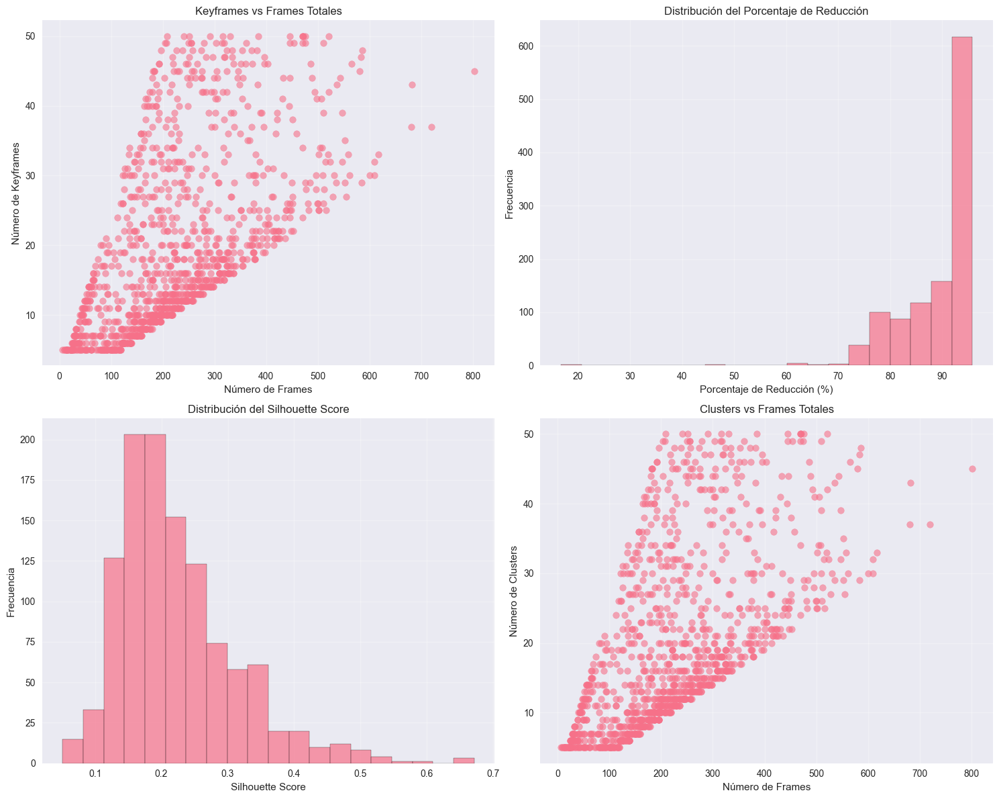

✅ Visualizaciones generadas


In [13]:
# Visualización de resultados del método KVS
if len(df_results) > 0:
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    
    # 1. Número de keyframes vs número de frames
    ax1 = axes[0, 0]
    ax1.scatter(df_results['n_frames'], df_results['n_keyframes'], alpha=0.6)
    ax1.set_xlabel('Número de Frames')
    ax1.set_ylabel('Número de Keyframes')
    ax1.set_title('Keyframes vs Frames Totales')
    ax1.grid(True, alpha=0.3)
    
    # 2. Porcentaje de reducción
    ax2 = axes[0, 1]
    ax2.hist(df_results['reduction_percentage'], bins=20, edgecolor='black', alpha=0.7)
    ax2.set_xlabel('Porcentaje de Reducción (%)')
    ax2.set_ylabel('Frecuencia')
    ax2.set_title('Distribución del Porcentaje de Reducción')
    ax2.grid(True, alpha=0.3)
    
    # 3. Silhouette score
    ax3 = axes[1, 0]
    ax3.hist(df_results['silhouette_score'], bins=20, edgecolor='black', alpha=0.7)
    ax3.set_xlabel('Silhouette Score')
    ax3.set_ylabel('Frecuencia')
    ax3.set_title('Distribución del Silhouette Score')
    ax3.grid(True, alpha=0.3)
    
    # 4. Número de clusters vs número de frames
    ax4 = axes[1, 1]
    ax4.scatter(df_results['n_frames'], df_results['n_clusters'], alpha=0.6)
    ax4.set_xlabel('Número de Frames')
    ax4.set_ylabel('Número de Clusters')
    ax4.set_title('Clusters vs Frames Totales')
    ax4.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    print("✅ Visualizaciones generadas")
else:
    print("⚠️  No hay resultados para visualizar")


## Visualización de Reducción: Primeros N Frames por Canal

Visualizamos cómo se resumen los primeros n frames de cada canal para tener una idea de la reducción.


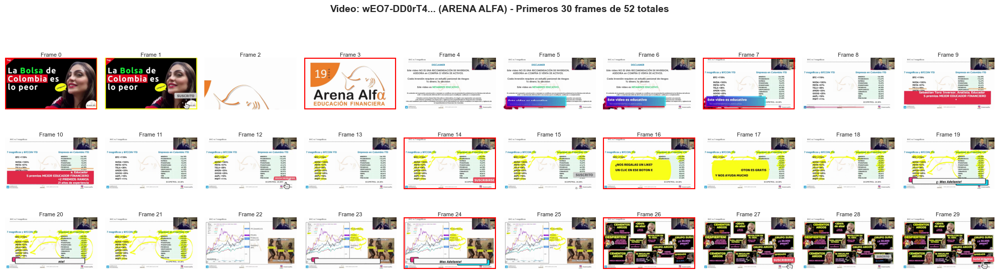

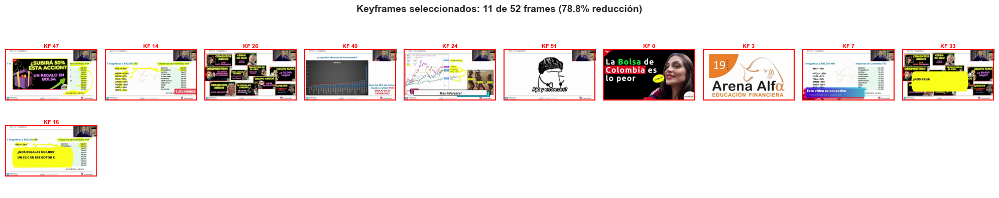


✅ Video wEO7-DD0rT4... procesado: 11 keyframes de 52 frames


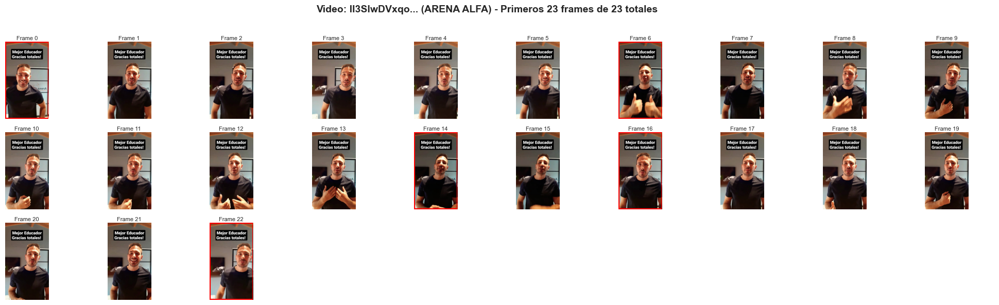

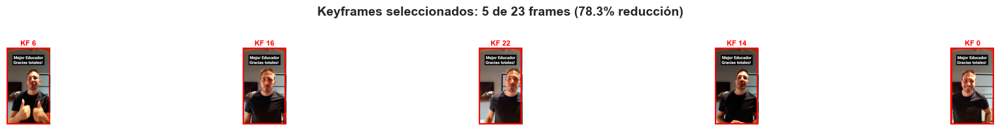


✅ Video II3SlwDVxqo... procesado: 5 keyframes de 23 frames


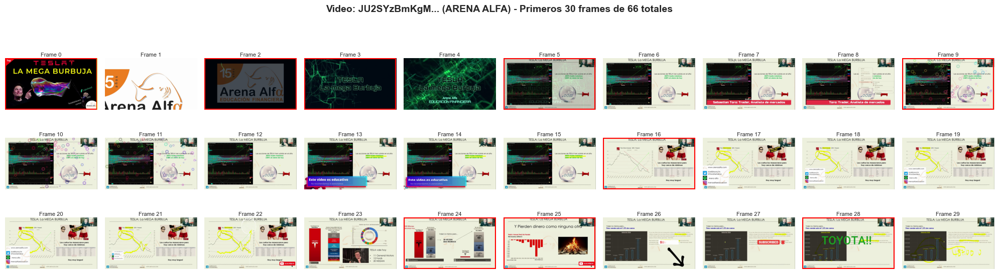

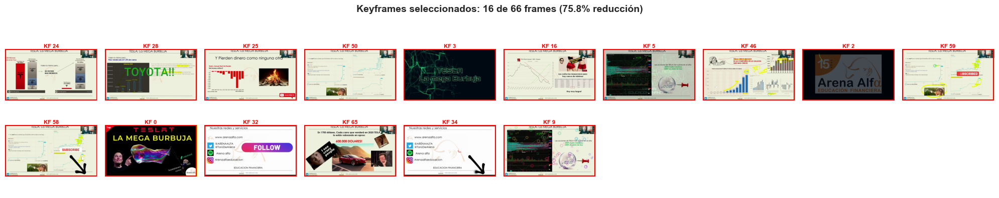


✅ Video JU2SYzBmKgM... procesado: 16 keyframes de 66 frames


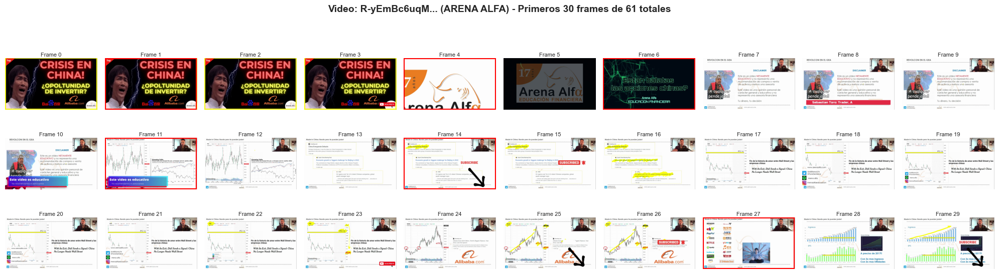

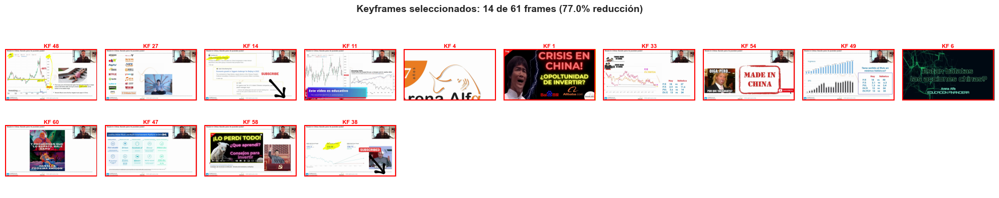


✅ Video R-yEmBc6uqM... procesado: 14 keyframes de 61 frames


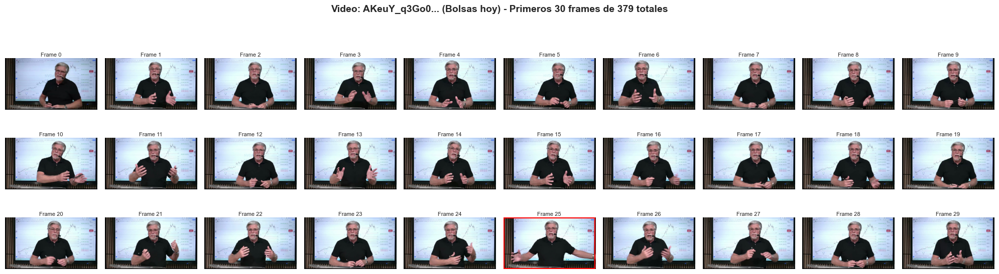

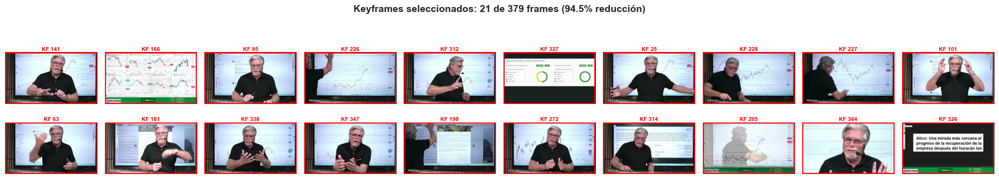


✅ Video AKeuY_q3Go0... procesado: 21 keyframes de 379 frames


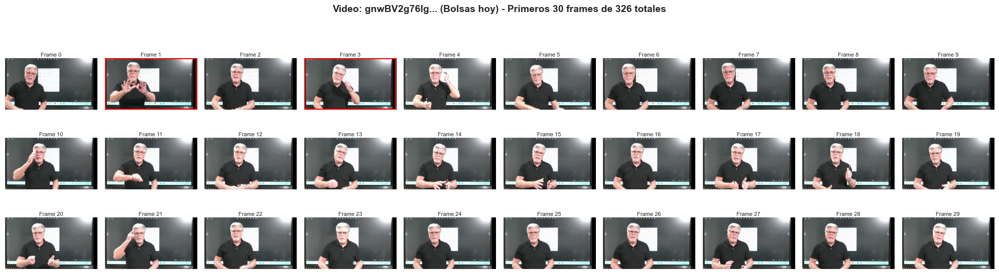

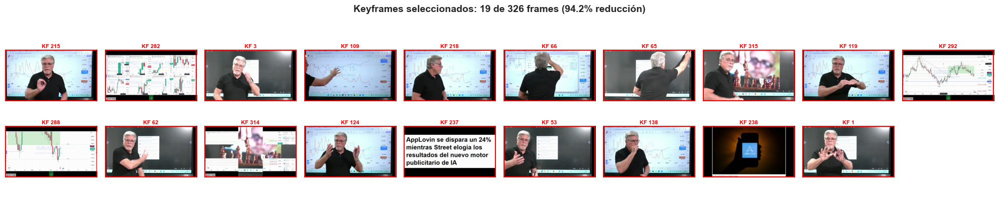


✅ Video gnwBV2g76lg... procesado: 19 keyframes de 326 frames


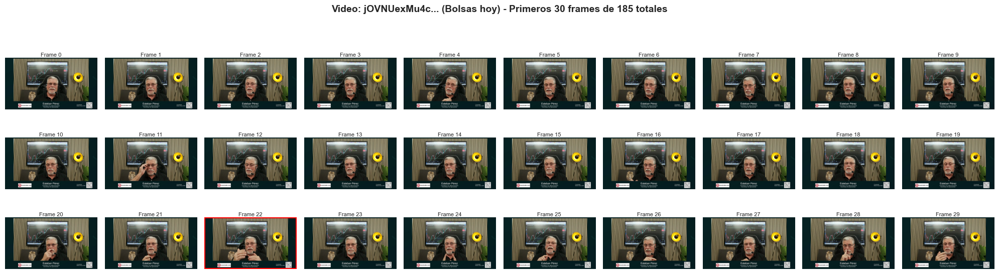

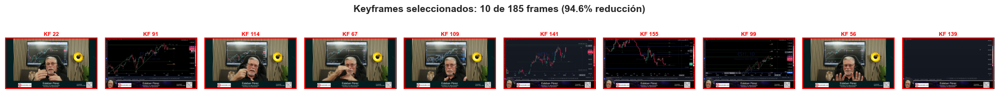


✅ Video jOVNUexMu4c... procesado: 10 keyframes de 185 frames


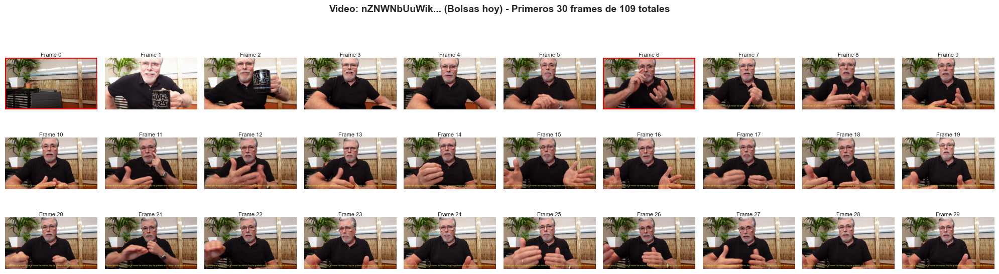

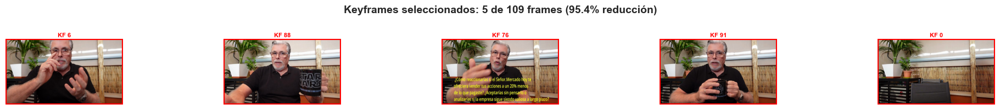


✅ Video nZNWNbUuWik... procesado: 5 keyframes de 109 frames


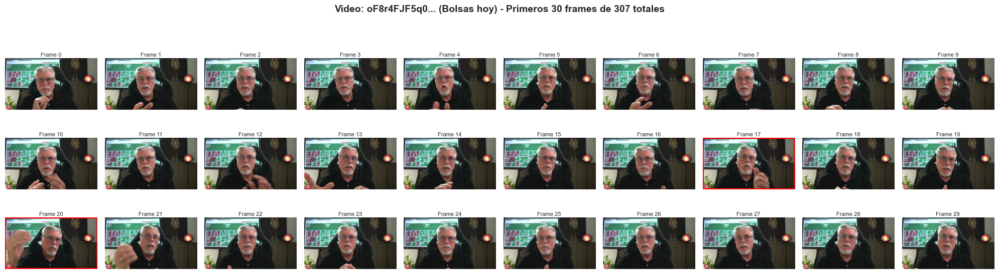

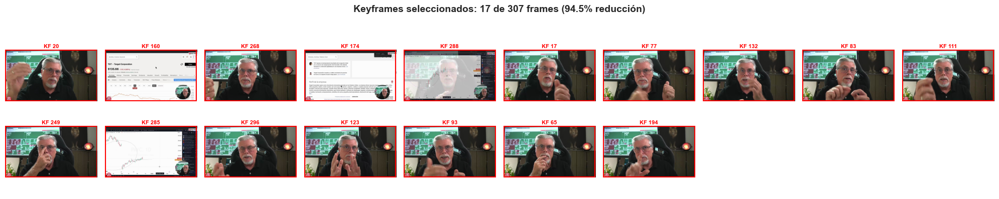


✅ Video oF8r4FJF5q0... procesado: 17 keyframes de 307 frames


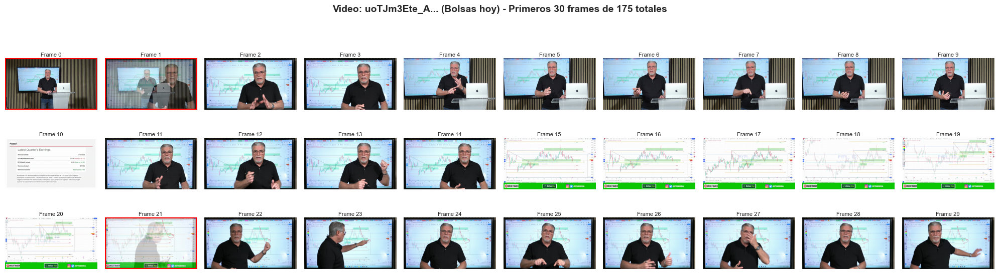

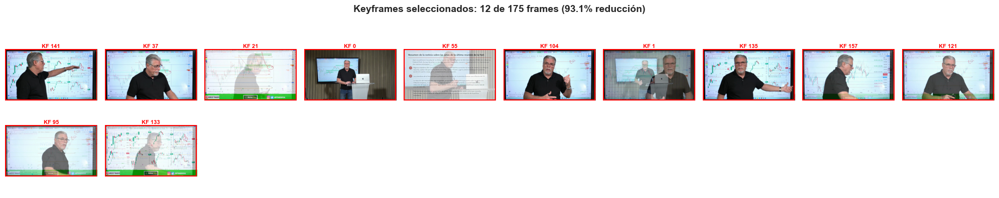


✅ Video uoTJm3Ete_A... procesado: 12 keyframes de 175 frames


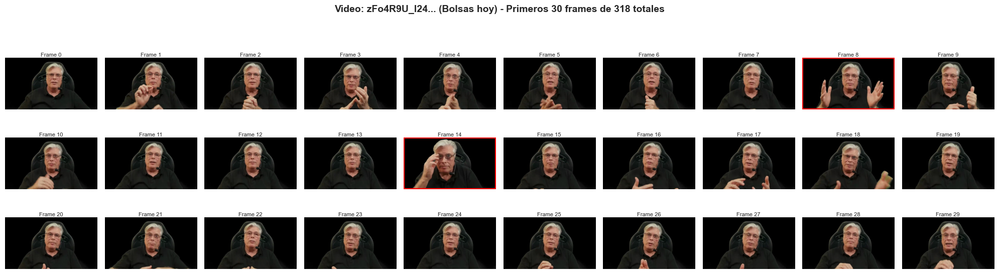

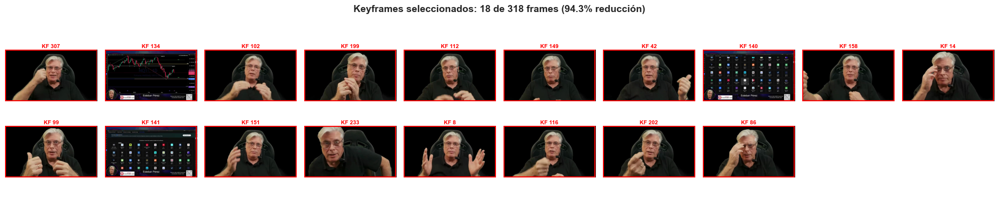


✅ Video zFo4R9U_l24... procesado: 18 keyframes de 318 frames


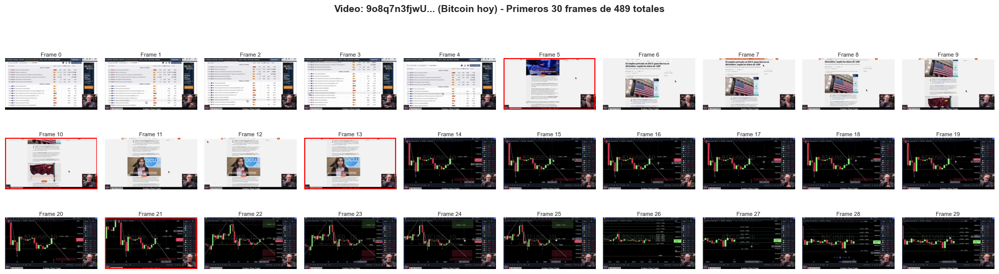

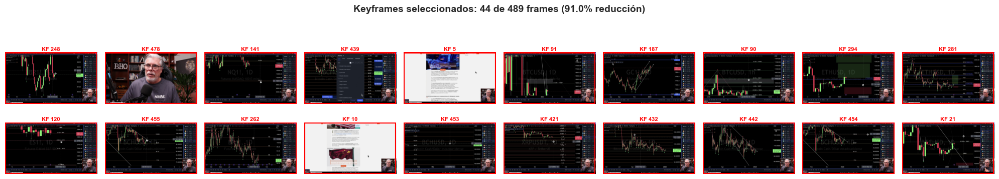


✅ Video 9o8q7n3fjwU... procesado: 44 keyframes de 489 frames


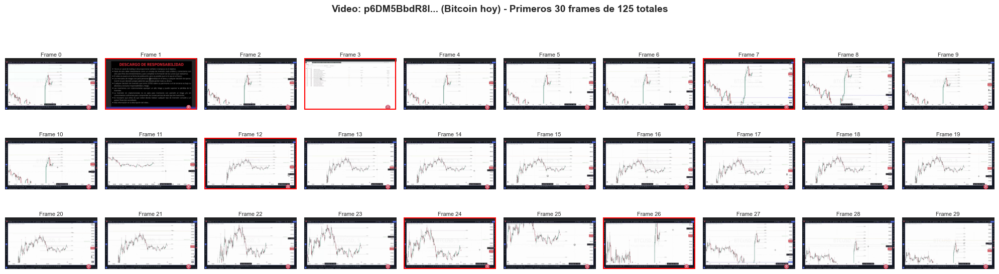

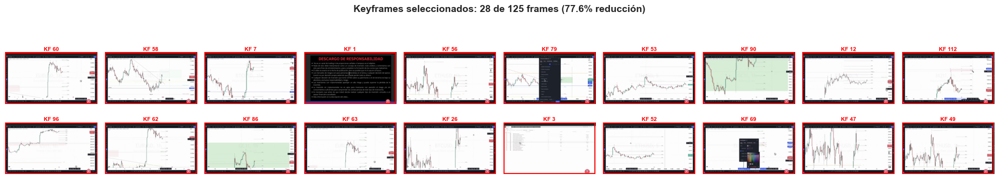


✅ Video p6DM5BbdR8I... procesado: 28 keyframes de 125 frames


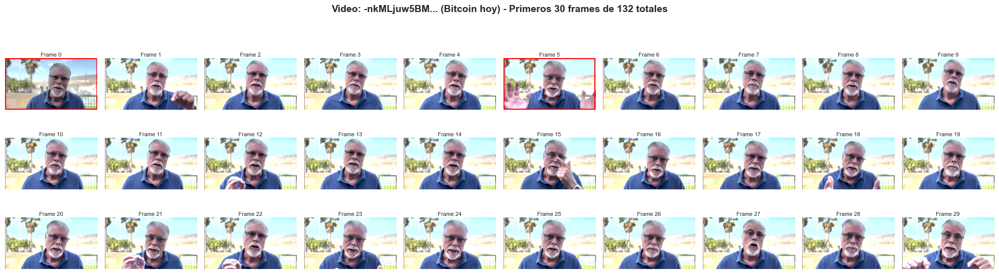

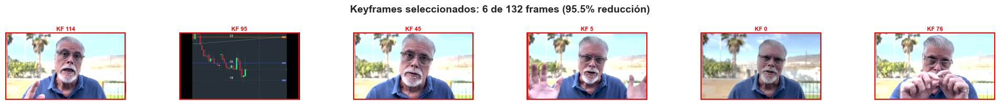


✅ Video -nkMLjuw5BM... procesado: 6 keyframes de 132 frames


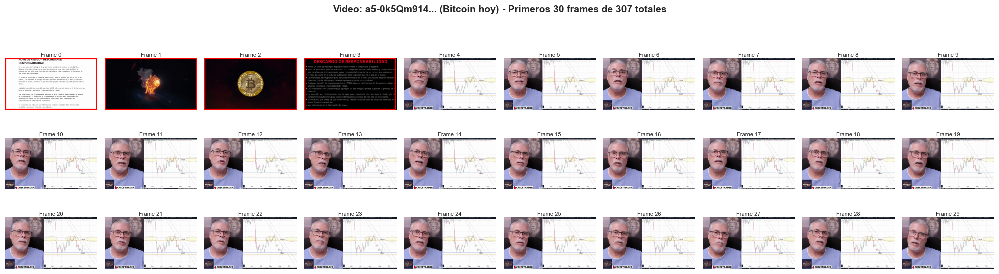

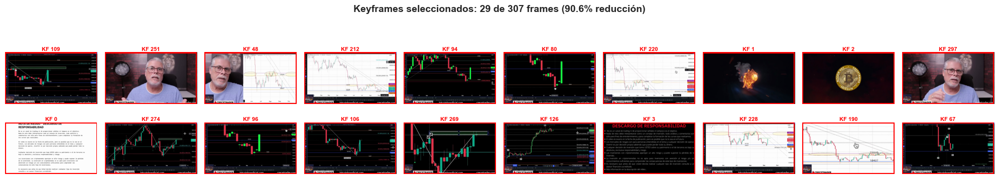


✅ Video a5-0k5Qm914... procesado: 29 keyframes de 307 frames


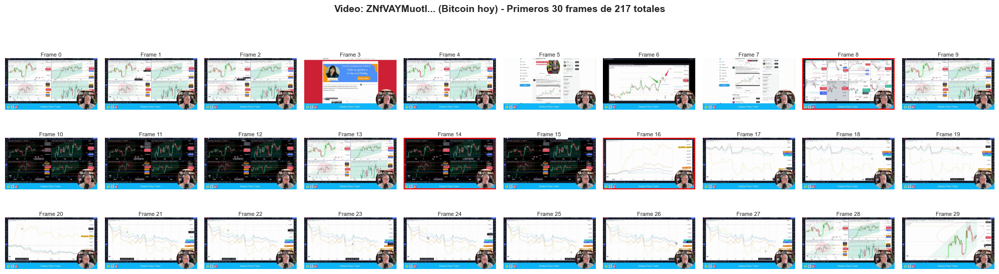

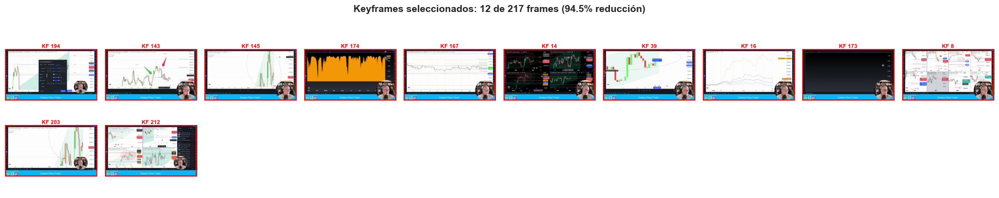


✅ Video ZNfVAYMuotI... procesado: 12 keyframes de 217 frames


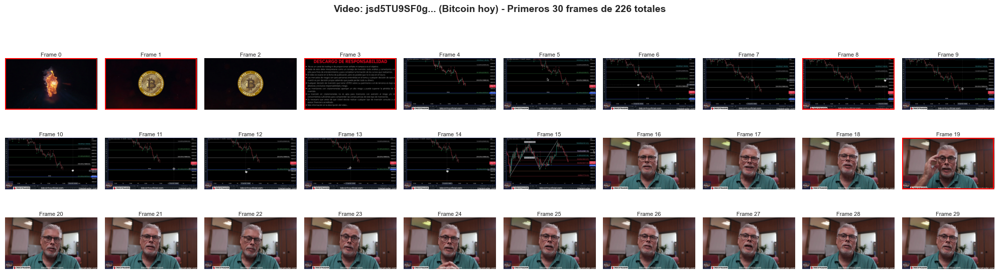

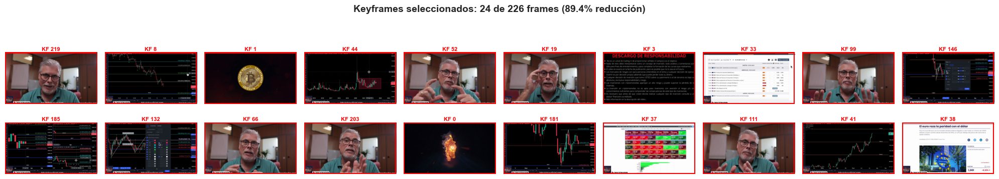


✅ Video jsd5TU9SF0g... procesado: 24 keyframes de 226 frames


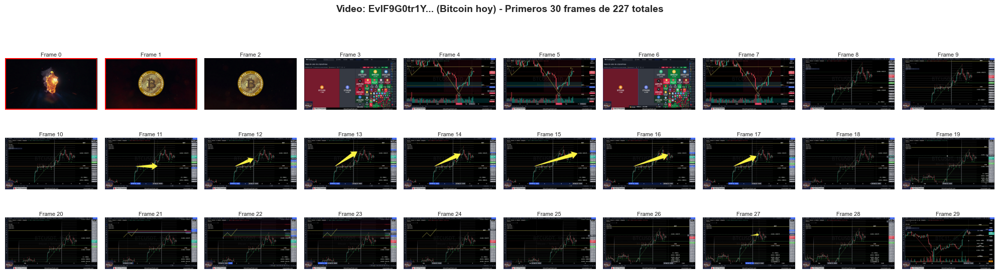

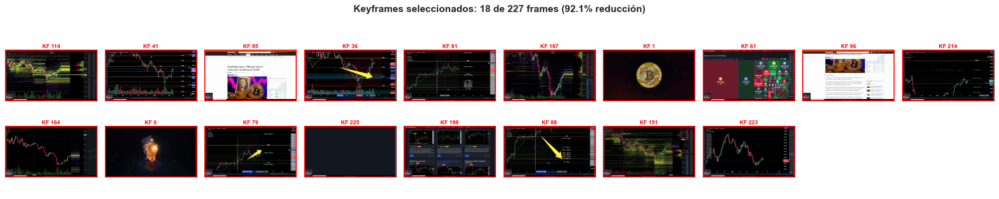


✅ Video EvlF9G0tr1Y... procesado: 18 keyframes de 227 frames


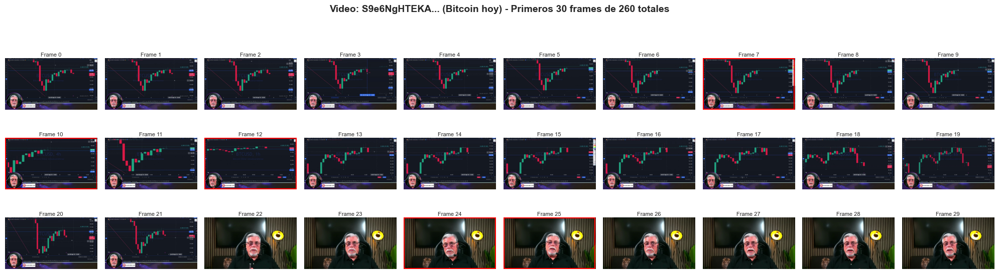

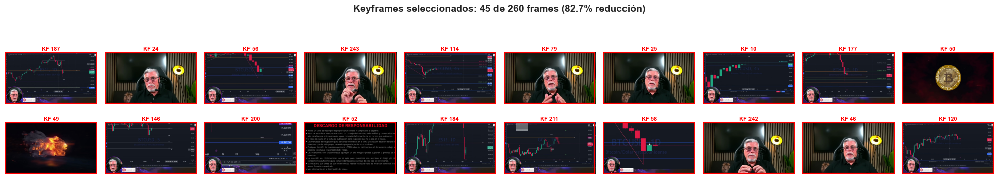


✅ Video S9e6NgHTEKA... procesado: 45 keyframes de 260 frames


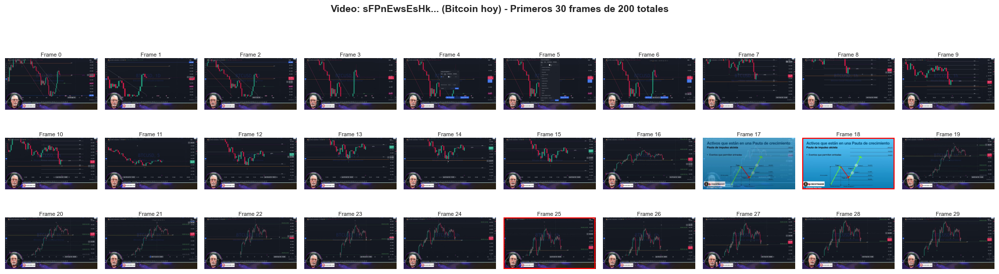

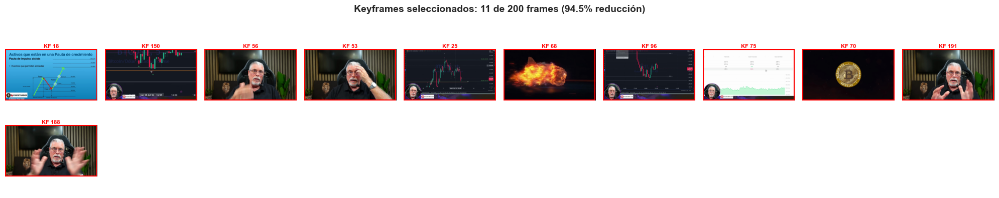


✅ Video sFPnEwsEsHk... procesado: 11 keyframes de 200 frames


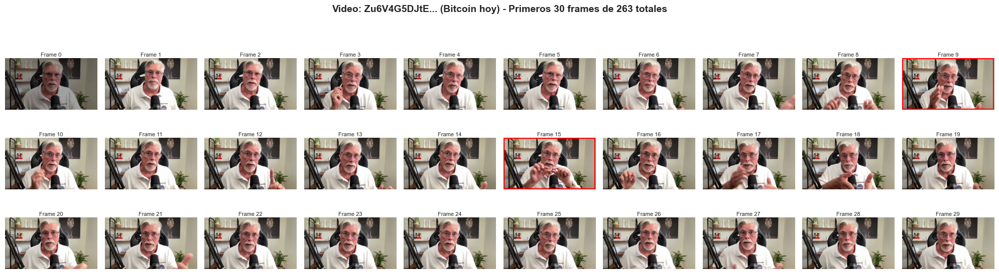

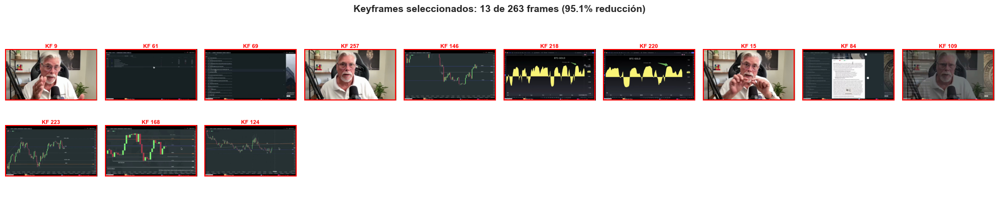


✅ Video Zu6V4G5DJtE... procesado: 13 keyframes de 263 frames


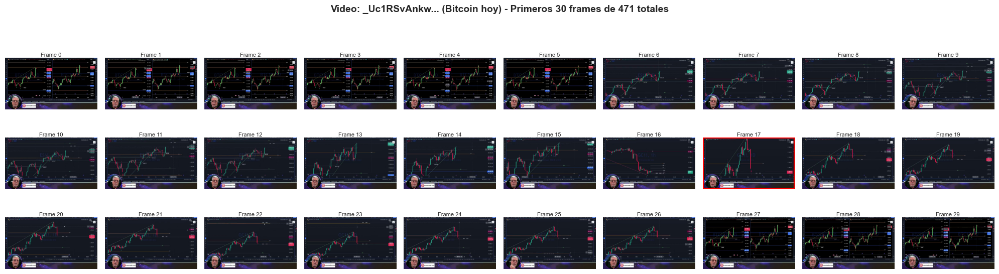

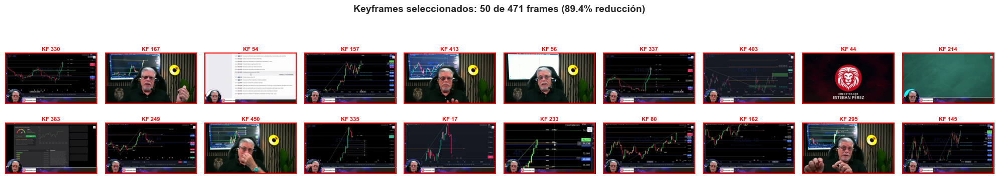


✅ Video _Uc1RSvAnkw... procesado: 50 keyframes de 471 frames


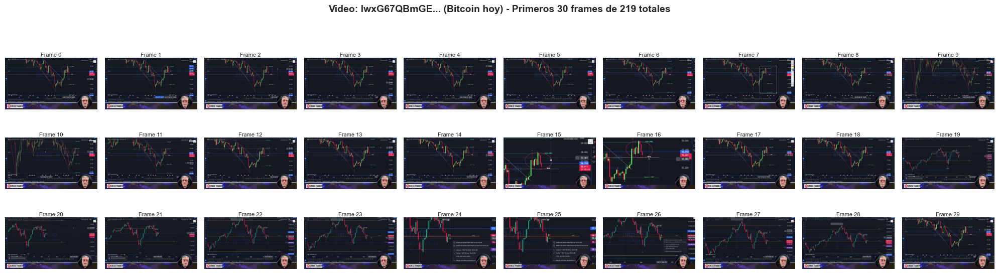

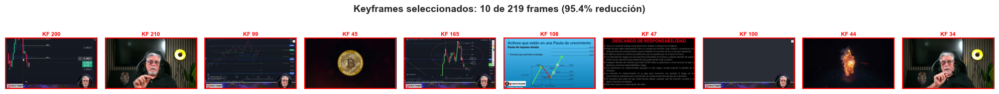


✅ Video IwxG67QBmGE... procesado: 10 keyframes de 219 frames


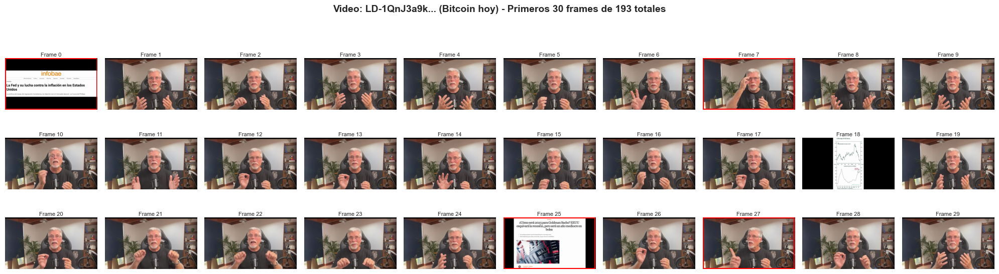

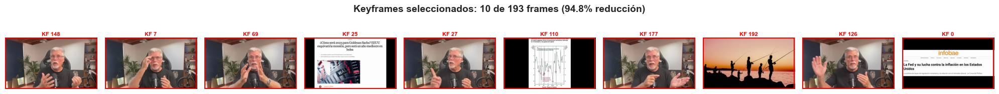


✅ Video LD-1QnJ3a9k... procesado: 10 keyframes de 193 frames


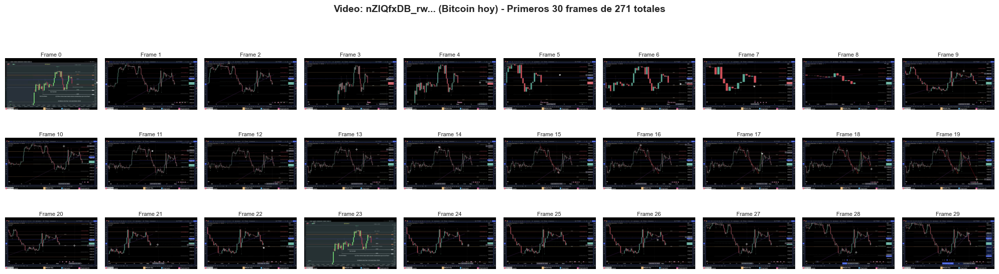

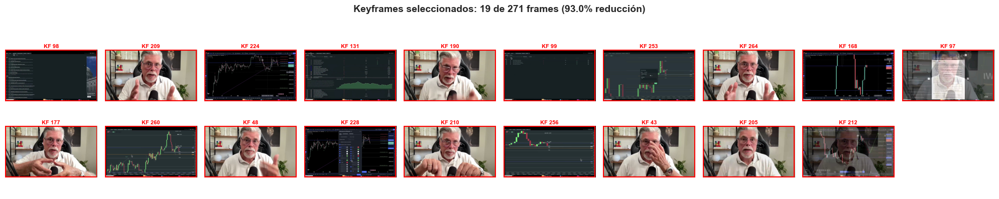


✅ Video nZlQfxDB_rw... procesado: 19 keyframes de 271 frames


In [14]:
# Visualización de los primeros N frames de cada canal
# Mostrar imágenes reales: primeros N frames arriba, keyframes abajo
N_FRAMES_TO_SHOW = 30  # Número de frames a visualizar (reducido para mejor visualización)

if len(results_detailed) > 0:
    from PIL import Image
    import os
    
    # Agrupar por canal
    from collections import defaultdict
    videos_by_channel = defaultdict(list)
    for result in results_detailed[:25]:
        channel = result['channel_name']
        videos_by_channel[channel].append(result)
    
    # Crear visualización para cada canal
    for channel_name, channel_videos in videos_by_channel.items():
        # Para cada video del canal, mostrar imágenes
        for video_result in channel_videos:
            video_id = video_result['video_id']
            frame_paths = video_result['frame_paths']
            keyframes = video_result['keyframes']
            is_keyframe = video_result['is_keyframe']
            n_frames = video_result['n_frames']
            n_keyframes = video_result['n_keyframes']
            
            # Tomar los primeros N frames
            n_show = min(N_FRAMES_TO_SHOW, n_frames)
            first_n_frames = frame_paths[:n_show]
            
            # Mostrar imágenes de los primeros N frames
            if len(first_n_frames) > 0:
                # Crear grid para las imágenes
                n_cols = min(10, len(first_n_frames))
                n_rows = (len(first_n_frames) + n_cols - 1) // n_cols
                
                # Crear figura para los primeros N frames
                fig_frames, axes_frames = plt.subplots(n_rows, n_cols, figsize=(20, 2 * n_rows))
                fig_frames.suptitle(f'Video: {video_id[:12]}... ({channel_name}) - Primeros {n_show} frames de {n_frames} totales', 
                                   fontsize=14, fontweight='bold', y=0.98)
                
                # Aplanar axes para acceso más fácil
                if n_rows == 1 and n_cols == 1:
                    axes_flat = [axes_frames]
                elif n_rows == 1:
                    axes_flat = axes_frames.flatten() if hasattr(axes_frames, 'flatten') else [axes_frames]
                elif n_cols == 1:
                    axes_flat = axes_frames.flatten() if hasattr(axes_frames, 'flatten') else [axes_frames]
                else:
                    axes_flat = axes_frames.flatten()
                
                for idx, frame_path in enumerate(first_n_frames):
                    ax = axes_flat[idx]
                    ax.axis('off')
                    
                    # Cargar y mostrar imagen
                    if os.path.exists(frame_path):
                        try:
                            img = Image.open(frame_path)
                            ax.imshow(img)
                            # Marcar si es keyframe
                            if frame_path in keyframes:
                                # Agregar borde rojo
                                from matplotlib.patches import Rectangle
                                rect = Rectangle((0, 0), img.width, img.height, 
                                                 fill=False, edgecolor='red', linewidth=3, transform=ax.transData)
                                ax.add_patch(rect)
                            ax.set_title(f'Frame {idx}', fontsize=8, pad=2)
                        except Exception as e:
                            ax.text(0.5, 0.5, f'Error\n{str(e)[:20]}', 
                                   ha='center', va='center', fontsize=6, transform=ax.transAxes)
                    else:
                        ax.text(0.5, 0.5, 'Not found', ha='center', va='center', fontsize=6, transform=ax.transAxes)
                
                # Ocultar subplots vacíos
                for idx in range(len(first_n_frames), len(axes_flat)):
                    axes_flat[idx].axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            # Mostrar imágenes de los keyframes
            if len(keyframes) > 0:
                # Limitar número de keyframes a mostrar (máximo 20)
                keyframes_to_show = keyframes[:20]
                
                # Crear grid para las imágenes de keyframes
                n_cols_kf = min(10, len(keyframes_to_show))
                n_rows_kf = (len(keyframes_to_show) + n_cols_kf - 1) // n_cols_kf
                
                # Crear figura para los keyframes
                fig_keyframes, axes_keyframes = plt.subplots(n_rows_kf, n_cols_kf, figsize=(20, 2 * n_rows_kf))
                fig_keyframes.suptitle(f'Keyframes seleccionados: {n_keyframes} de {n_frames} frames ({100*(1-n_keyframes/n_frames):.1f}% reducción)', 
                                      fontsize=14, fontweight='bold', y=0.98)
                
                # Aplanar axes para acceso más fácil
                if n_rows_kf == 1 and n_cols_kf == 1:
                    axes_kf_flat = [axes_keyframes]
                elif n_rows_kf == 1:
                    axes_kf_flat = axes_keyframes.flatten() if hasattr(axes_keyframes, 'flatten') else [axes_keyframes]
                elif n_cols_kf == 1:
                    axes_kf_flat = axes_keyframes.flatten() if hasattr(axes_keyframes, 'flatten') else [axes_keyframes]
                else:
                    axes_kf_flat = axes_keyframes.flatten()
                
                for idx, keyframe_path in enumerate(keyframes_to_show):
                    ax = axes_kf_flat[idx]
                    ax.axis('off')
                    
                    # Cargar y mostrar imagen
                    if os.path.exists(keyframe_path):
                        try:
                            img = Image.open(keyframe_path)
                            ax.imshow(img)
                            # Marcar con borde rojo
                            from matplotlib.patches import Rectangle
                            rect = Rectangle((0, 0), img.width, img.height, 
                                             fill=False, edgecolor='red', linewidth=3, transform=ax.transData)
                            ax.add_patch(rect)
                            # Encontrar índice del frame
                            frame_idx = frame_paths.index(keyframe_path) if keyframe_path in frame_paths else idx
                            ax.set_title(f'KF {frame_idx}', fontsize=8, color='red', fontweight='bold', pad=2)
                        except Exception as e:
                            ax.text(0.5, 0.5, f'Error\n{str(e)[:20]}', 
                                   ha='center', va='center', fontsize=6, transform=ax.transAxes)
                    else:
                        ax.text(0.5, 0.5, 'Not found', ha='center', va='center', fontsize=6, transform=ax.transAxes)
                
                # Ocultar subplots vacíos
                for idx in range(len(keyframes_to_show), len(axes_kf_flat)):
                    axes_kf_flat[idx].axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            print(f"\n✅ Video {video_id[:12]}... procesado: {n_keyframes} keyframes de {n_frames} frames")
            print("=" * 80)
else:
    print("⚠️  No hay resultados detallados para visualizar")
    print("   Ejecuta primero la celda que aplica el método KVS")


## Resumen y Conclusiones

### Método Implementado (según el artículo):
**KVS (K-means clustering-based Video Summarization)**

### Características del Método:
1. **K-Means Clustering**: Agrupa frames usando Euclidean distance
2. **Optimización con Silhouette Score**: Determina el número óptimo de clusters (SS más cercano a 1)
3. **Selección de Keyframes**: Frame con **mayor disimilitud** al centroide de cada cluster
4. **Métrica de Distancia**: Euclidean distance (según el artículo)

### Métricas de Evaluación (según el artículo):
- **Número de keyframes**: Cantidad de frames seleccionados
- **Porcentaje de reducción**: Reducción del número de frames
- **Silhouette Score**: Calidad del clustering (valores cercanos a 1 indican clusters bien separados)
- **Número de clusters**: Número de grupos identificados
- **Precision, Recall, F-Measure**: Métricas mencionadas en el artículo (requieren ground truth)

### Referencia del Artículo:
"Static Video Summarization Using Transfer Learning and Clustering"  
*Shamal Kashid, Lalit K. Awasthi, Krishan Berwal, Parul Saini*

**Resultados del artículo:**
- F-Measure promedio: 73.1% (Open Video dataset)
- F-Measure promedio: 76.3% (YouTube dataset)


# Documentación: Funcionamiento del Método KVS

## ¿Se entrena un modelo una vez o por cada video?

**Respuesta: En el método KVS se entrena un modelo K-Means por video. No hay un modelo preentrenado que se reutilice.**

## Cómo funciona el método KVS

### 1. Clustering no supervisado por video:

- Cada video tiene frames únicos con características visuales diferentes
- El clustering agrupa los frames de ese video específico según sus similitudes visuales
- No se puede generalizar un modelo entrenado en otro video

### 2. Número óptimo de clusters por video:

- Se calcula usando Silhouette Score para cada video
- Cada video puede tener un número óptimo diferente según su contenido, duración y número de frames

### 3. Entrenamiento del modelo por video:

```python
# Calcula número óptimo de clusters para este video
n_clusters, _, _ = calculate_optimal_clusters(features)

# Crea un nuevo modelo K-Means para este video
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)

# Entrena el modelo con los features de este video específico
labels = kmeans.fit_predict(features)
```

## Por qué es así

1. **Cada video tiene contenido diferente**: Los clusters de un video no aplican a otro
2. **El número óptimo de clusters varía**: Depende del contenido y la duración de cada video
3. **Es un método no supervisado**: Agrupa los frames de cada video individualmente, no aprende patrones generales entre videos

## Resumen

**Sí, siempre se debe aplicar clustering y entrenar el modelo K-Means para cada video.** No hay un modelo preentrenado que se reutilice. El proceso es:

1. Extraer features de los frames del video
2. Calcular el número óptimo de clusters para ese video
3. Entrenar un modelo K-Means con los features de ese video
4. Seleccionar los keyframes basándose en los clusters de ese video

**Esto es diferente de un modelo supervisado que se entrena una vez y luego se usa en inferencia. El método KVS es no supervisado y específico para cada video.**

## Clasificación de Etapas del Pipeline

### ¿La generación de embeddings es preprocesamiento o modelado?

**Respuesta: Según el artículo, la generación de embeddings se clasifica como PREPROCESAMIENTO.**

#### Estructura del Pipeline según el artículo:

1. **Preprocesamiento (Sección 3.1: Frames and Feature Extraction)**:
   - Conversión de videos a frames individuales
   - **Extracción de features/embeddings usando modelos pre-entrenados** (ResNet-50, GoogleNet)
   - Fusión de features de múltiples CNNs (Dual-CNN)
   - Mapeo de features extraídos

2. **Modelado (Sección 3.2: K-Means Clustering)**:
   - Aplicación de K-Means clustering sobre los embeddings
   - Optimización del número de clusters usando Silhouette Score
   - Agrupación de frames según similitudes visuales

3. **Selección de Keyframes (Sección 3.3: Keyframe Selection)**:
   - Selección de frames representativos de cada cluster
   - Frame con mayor disimilitud al centroide

#### ¿Por qué se clasifica como preprocesamiento?

- **Preparación de datos**: Los embeddings son representaciones de los frames que se preparan antes de aplicar el algoritmo de clustering
- **Transformación de datos**: Convierte frames (imágenes) en vectores numéricos (embeddings) que son el input del modelo
- **Uso de modelos pre-entrenados**: Los modelos (ResNet-50, GoogleNet) ya están entrenados (transfer learning), no se entrenan en este pipeline
- **Etapa previa al modelado**: Los embeddings son el input para el algoritmo de clustering (K-Means), que es la etapa de modelado

#### En términos técnicos:

- **Preprocesamiento**: Limpieza, normalización, transformación de datos, extracción de features
- **Feature Engineering/Extraction**: Extracción de representaciones usando modelos o técnicas específicas (parte del preprocesamiento)
- **Modelado**: Aplicación de algoritmos de ML (K-Means clustering en este caso)

**Conclusión**: La generación de embeddings es una etapa de **preprocesamiento** que prepara los datos (frames) para el algoritmo de modelado (K-Means clustering).


## Resumen Final y Estadísticas de Resultados

Resumen completo de los resultados obtenidos con el método KVS según las métricas del artículo.


In [15]:
# Resumen Final y Estadísticas de Resultados
# Métricas según el artículo: Reduction Percentage, Silhouette Score, Número de Clusters

print("=" * 80)
print("📊 RESUMEN FINAL Y ESTADÍSTICAS DE RESULTADOS")
print("=" * 80)
print("\nMétodo: KVS (K-means clustering-based Video Summarization)")
print("Métricas Principales: Reduction Percentage, Silhouette Score, Número de Clusters")
print("=" * 80)

if 'df_results' in locals() and len(df_results) > 0:
    # Estadísticas generales
    print("\n📈 ESTADÍSTICAS GENERALES:")
    print("-" * 80)
    print(f"   Total de videos analizados: {df_results['video_id'].nunique()}")
    print(f"   Total de resultados: {len(df_results)}")
    print(f"   Canales analizados: {df_results['channel_name'].nunique()}")
    print(f"   Canales: {', '.join(df_results['channel_name'].unique())}")
    
    # Estadísticas globales
    print("\n📊 ESTADÍSTICAS GLOBALES:")
    print("-" * 80)
    print(f"   Keyframes promedio: {df_results['n_keyframes'].mean():.2f} ± {df_results['n_keyframes'].std():.2f}")
    print(f"   Reduction Percentage promedio: {df_results['reduction_percentage'].mean():.2f}% ± {df_results['reduction_percentage'].std():.2f}%")
    print(f"   Reduction Percentage mínimo: {df_results['reduction_percentage'].min():.2f}%")
    print(f"   Reduction Percentage máximo: {df_results['reduction_percentage'].max():.2f}%")
    print(f"   Silhouette Score promedio: {df_results['silhouette_score'].mean():.4f} ± {df_results['silhouette_score'].std():.4f}")
    print(f"   Silhouette Score mínimo: {df_results['silhouette_score'].min():.4f}")
    print(f"   Silhouette Score máximo: {df_results['silhouette_score'].max():.4f}")
    print(f"   Número de clusters promedio: {df_results['n_clusters'].mean():.2f} ± {df_results['n_clusters'].std():.2f}")
    print(f"   Frames promedio por video: {df_results['n_frames'].mean():.2f} ± {df_results['n_frames'].std():.2f}")
    
    # Estadísticas por canal
    print("\n📺 ESTADÍSTICAS POR CANAL:")
    print("-" * 80)
    for channel in sorted(df_results['channel_name'].unique()):
        channel_data = df_results[df_results['channel_name'] == channel]
        print(f"\n   Canal: {channel}")
        print(f"      Videos: {channel_data['video_id'].nunique()}")
        print(f"      Keyframes promedio: {channel_data['n_keyframes'].mean():.2f} ± {channel_data['n_keyframes'].std():.2f}")
        print(f"      Reduction Percentage promedio: {channel_data['reduction_percentage'].mean():.2f}% ± {channel_data['reduction_percentage'].std():.2f}%")
        print(f"      Silhouette Score promedio: {channel_data['silhouette_score'].mean():.4f} ± {channel_data['silhouette_score'].std():.4f}")
        print(f"      Número de clusters promedio: {channel_data['n_clusters'].mean():.2f} ± {channel_data['n_clusters'].std():.2f}")
        print(f"      Frames promedio por video: {channel_data['n_frames'].mean():.2f} ± {channel_data['n_frames'].std():.2f}")
    
    # Mejores resultados
    print("\n🏆 MEJORES RESULTADOS:")
    print("-" * 80)
    
    # Mejor Reduction Percentage
    best_reduction = df_results.loc[df_results['reduction_percentage'].idxmax()]
    print(f"   Mejor Reduction Percentage:")
    print(f"      Video: {best_reduction['video_id']} ({best_reduction['channel_name']})")
    print(f"      Reduction: {best_reduction['reduction_percentage']:.2f}%")
    print(f"      Keyframes: {best_reduction['n_keyframes']:.0f} de {best_reduction['n_frames']:.0f} frames")
    print(f"      Silhouette Score: {best_reduction['silhouette_score']:.4f}")
    print(f"      Clusters: {best_reduction['n_clusters']:.0f}")
    
    # Mejor Silhouette Score
    best_silhouette = df_results.loc[df_results['silhouette_score'].idxmax()]
    print(f"\n   Mejor Silhouette Score:")
    print(f"      Video: {best_silhouette['video_id']} ({best_silhouette['channel_name']})")
    print(f"      Silhouette Score: {best_silhouette['silhouette_score']:.4f}")
    print(f"      Reduction: {best_silhouette['reduction_percentage']:.2f}%")
    print(f"      Keyframes: {best_silhouette['n_keyframes']:.0f} de {best_silhouette['n_frames']:.0f} frames")
    print(f"      Clusters: {best_silhouette['n_clusters']:.0f}")
    
    # Análisis de calidad del clustering
    print("\n📊 ANÁLISIS DE CALIDAD DEL CLUSTERING:")
    print("-" * 80)
    high_quality = df_results[df_results['silhouette_score'] >= 0.3]
    medium_quality = df_results[(df_results['silhouette_score'] >= 0.2) & (df_results['silhouette_score'] < 0.3)]
    low_quality = df_results[df_results['silhouette_score'] < 0.2]
    
    print(f"   Videos con Silhouette Score ≥ 0.3 (alta calidad): {len(high_quality)} ({len(high_quality)/len(df_results)*100:.1f}%)")
    if len(high_quality) > 0:
        print(f"      Reduction promedio: {high_quality['reduction_percentage'].mean():.2f}%")
        print(f"      Clusters promedio: {high_quality['n_clusters'].mean():.2f}")
    
    print(f"   Videos con Silhouette Score 0.2-0.3 (calidad media): {len(medium_quality)} ({len(medium_quality)/len(df_results)*100:.1f}%)")
    if len(medium_quality) > 0:
        print(f"      Reduction promedio: {medium_quality['reduction_percentage'].mean():.2f}%")
        print(f"      Clusters promedio: {medium_quality['n_clusters'].mean():.2f}")
    
    print(f"   Videos con Silhouette Score < 0.2 (baja calidad): {len(low_quality)} ({len(low_quality)/len(df_results)*100:.1f}%)")
    if len(low_quality) > 0:
        print(f"      Reduction promedio: {low_quality['reduction_percentage'].mean():.2f}%")
        print(f"      Clusters promedio: {low_quality['n_clusters'].mean():.2f}")
    
    # Relación entre métricas
    print("\n🔗 RELACIÓN ENTRE MÉTRICAS:")
    print("-" * 80)
    correlation = df_results[['reduction_percentage', 'silhouette_score', 'n_clusters', 'n_keyframes']].corr()
    print(f"   Correlación Reduction vs Silhouette: {correlation.loc['reduction_percentage', 'silhouette_score']:.4f}")
    print(f"   Correlación Reduction vs Clusters: {correlation.loc['reduction_percentage', 'n_clusters']:.4f}")
    print(f"   Correlación Silhouette vs Clusters: {correlation.loc['silhouette_score', 'n_clusters']:.4f}")
    
    print("\n" + "=" * 80)
    print("✅ Resumen completado")
    print("=" * 80)
else:
    print("\n⚠️  No hay resultados disponibles. Ejecuta primero las celdas de procesamiento.")


📊 RESUMEN FINAL Y ESTADÍSTICAS DE RESULTADOS

Método: KVS (K-means clustering-based Video Summarization)
Métricas Principales: Reduction Percentage, Silhouette Score, Número de Clusters

📈 ESTADÍSTICAS GENERALES:
--------------------------------------------------------------------------------
   Total de videos analizados: 1128
   Total de resultados: 1128
   Canales analizados: 3
   Canales: ARENA ALFA, Bolsas hoy, Bitcoin hoy

📊 ESTADÍSTICAS GLOBALES:
--------------------------------------------------------------------------------
   Keyframes promedio: 19.78 ± 12.59
   Reduction Percentage promedio: 89.46% ± 7.13%
   Reduction Percentage mínimo: 16.67%
   Reduction Percentage máximo: 95.80%
   Silhouette Score promedio: 0.2228 ± 0.0898
   Silhouette Score mínimo: 0.0511
   Silhouette Score máximo: 0.6710
   Número de clusters promedio: 19.78 ± 12.59
   Frames promedio por video: 224.63 ± 127.96

📺 ESTADÍSTICAS POR CANAL:
--------------------------------------------------------------

## Gráficos de Distribución de Resultados

Visualizaciones de las distribuciones de las métricas principales: Reduction Percentage, número de keyframes y Silhouette Score.


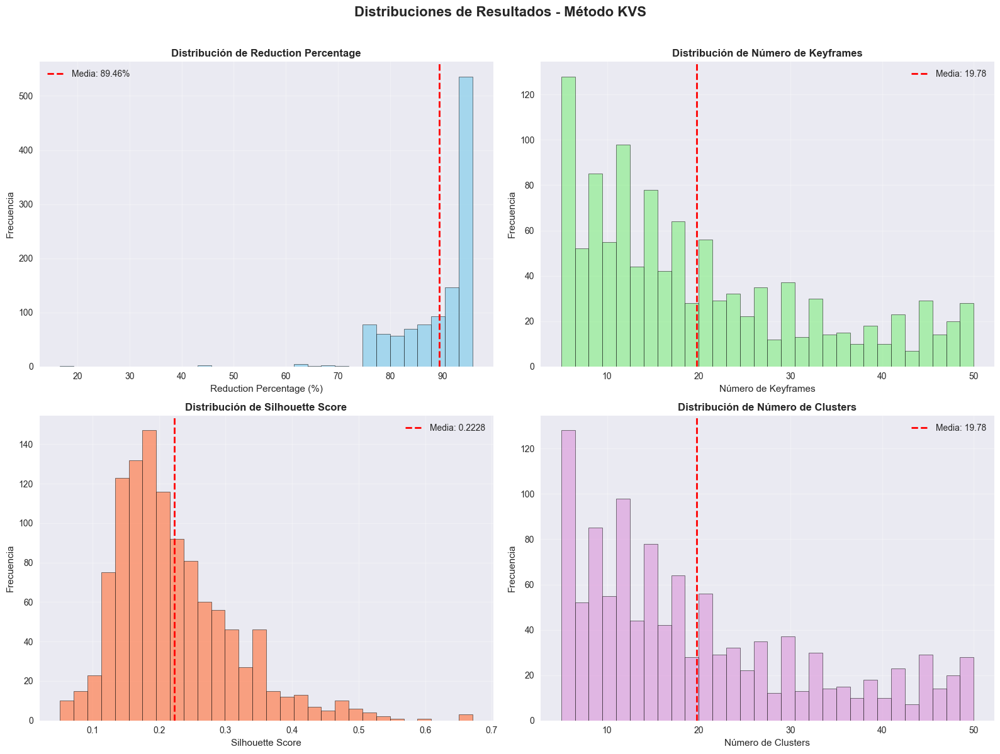

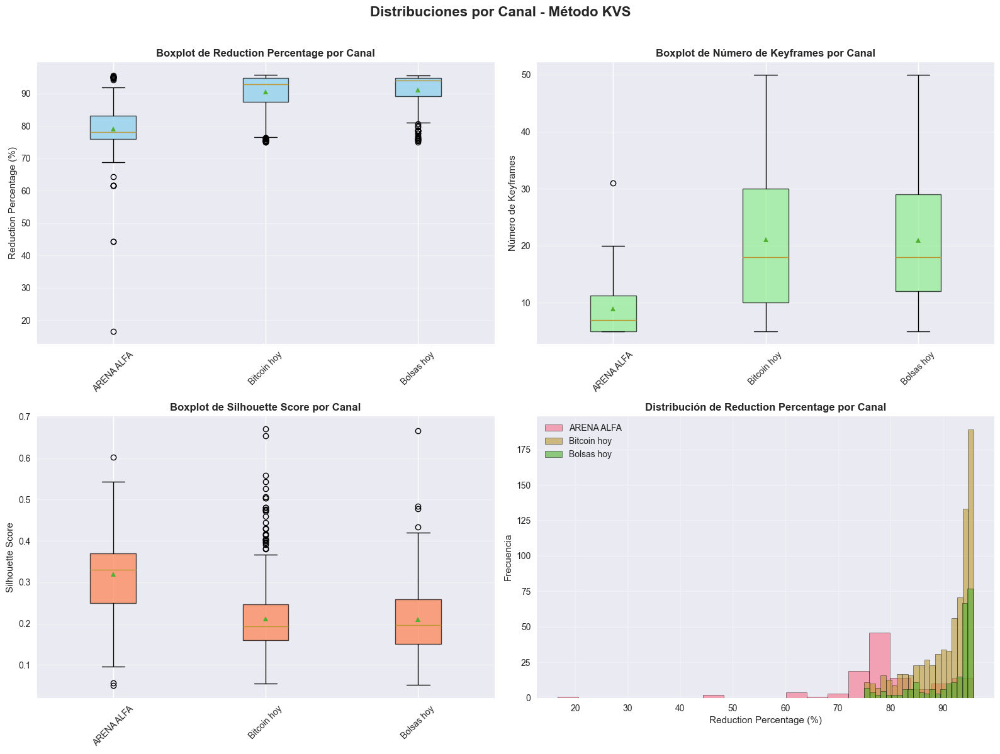

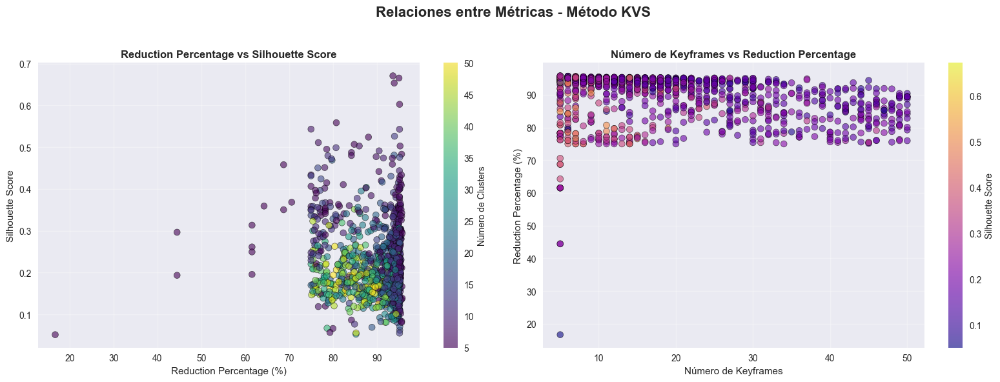

✅ Gráficos de distribución generados


In [16]:
# Gráficos de Distribución de Resultados
# Distribuciones: Reduction Percentage, Número de Keyframes, Silhouette Score

if 'df_results' in locals() and len(df_results) > 0:
    # Crear figura con subplots
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Distribuciones de Resultados - Método KVS', fontsize=16, fontweight='bold', y=0.995)
    
    # 1. Distribución de Reduction Percentage
    ax1 = axes[0, 0]
    ax1.hist(df_results['reduction_percentage'], bins=30, alpha=0.7, color='skyblue', 
            edgecolor='black', linewidth=0.5)
    ax1.axvline(df_results['reduction_percentage'].mean(), color='red', linestyle='--', 
               linewidth=2, label=f'Media: {df_results["reduction_percentage"].mean():.2f}%')
    ax1.set_xlabel('Reduction Percentage (%)', fontsize=11)
    ax1.set_ylabel('Frecuencia', fontsize=11)
    ax1.set_title('Distribución de Reduction Percentage', fontsize=12, fontweight='bold')
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # 2. Distribución de Número de Keyframes
    ax2 = axes[0, 1]
    ax2.hist(df_results['n_keyframes'], bins=30, alpha=0.7, color='lightgreen', 
            edgecolor='black', linewidth=0.5)
    ax2.axvline(df_results['n_keyframes'].mean(), color='red', linestyle='--', 
               linewidth=2, label=f'Media: {df_results["n_keyframes"].mean():.2f}')
    ax2.set_xlabel('Número de Keyframes', fontsize=11)
    ax2.set_ylabel('Frecuencia', fontsize=11)
    ax2.set_title('Distribución de Número de Keyframes', fontsize=12, fontweight='bold')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # 3. Distribución de Silhouette Score
    ax3 = axes[1, 0]
    ax3.hist(df_results['silhouette_score'], bins=30, alpha=0.7, color='coral', 
            edgecolor='black', linewidth=0.5)
    ax3.axvline(df_results['silhouette_score'].mean(), color='red', linestyle='--', 
               linewidth=2, label=f'Media: {df_results["silhouette_score"].mean():.4f}')
    ax3.set_xlabel('Silhouette Score', fontsize=11)
    ax3.set_ylabel('Frecuencia', fontsize=11)
    ax3.set_title('Distribución de Silhouette Score', fontsize=12, fontweight='bold')
    ax3.legend()
    ax3.grid(True, alpha=0.3)
    
    # 4. Distribución de Número de Clusters
    ax4 = axes[1, 1]
    ax4.hist(df_results['n_clusters'], bins=30, alpha=0.7, color='plum', 
            edgecolor='black', linewidth=0.5)
    ax4.axvline(df_results['n_clusters'].mean(), color='red', linestyle='--', 
               linewidth=2, label=f'Media: {df_results["n_clusters"].mean():.2f}')
    ax4.set_xlabel('Número de Clusters', fontsize=11)
    ax4.set_ylabel('Frecuencia', fontsize=11)
    ax4.set_title('Distribución de Número de Clusters', fontsize=12, fontweight='bold')
    ax4.legend()
    ax4.grid(True, alpha=0.3)
    
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()
    
    # Gráficos adicionales: Boxplots y distribuciones por Canal
    fig2, axes2 = plt.subplots(2, 2, figsize=(16, 12))
    fig2.suptitle('Distribuciones por Canal - Método KVS', fontsize=16, fontweight='bold', y=0.995)
    
    channels = sorted(df_results['channel_name'].unique())
    
    # 5. Boxplot de Reduction Percentage por Canal
    ax5 = axes2[0, 0]
    data_by_channel_reduction = [df_results[df_results['channel_name'] == ch]['reduction_percentage'].values 
                                for ch in channels]
    bp_reduction = ax5.boxplot(data_by_channel_reduction, labels=channels, patch_artist=True, showmeans=True)
    for patch in bp_reduction['boxes']:
        patch.set_facecolor('skyblue')
        patch.set_alpha(0.7)
    ax5.set_ylabel('Reduction Percentage (%)', fontsize=11)
    ax5.set_title('Boxplot de Reduction Percentage por Canal', fontsize=12, fontweight='bold')
    ax5.tick_params(axis='x', rotation=45)
    ax5.grid(True, alpha=0.3, axis='y')
    
    # 6. Boxplot de Número de Keyframes por Canal
    ax6 = axes2[0, 1]
    data_by_channel_kf = [df_results[df_results['channel_name'] == ch]['n_keyframes'].values 
                         for ch in channels]
    bp_kf = ax6.boxplot(data_by_channel_kf, labels=channels, patch_artist=True, showmeans=True)
    for patch in bp_kf['boxes']:
        patch.set_facecolor('lightgreen')
        patch.set_alpha(0.7)
    ax6.set_ylabel('Número de Keyframes', fontsize=11)
    ax6.set_title('Boxplot de Número de Keyframes por Canal', fontsize=12, fontweight='bold')
    ax6.tick_params(axis='x', rotation=45)
    ax6.grid(True, alpha=0.3, axis='y')
    
    # 7. Boxplot de Silhouette Score por Canal
    ax7 = axes2[1, 0]
    data_by_channel_sil = [df_results[df_results['channel_name'] == ch]['silhouette_score'].values 
                          for ch in channels]
    bp_sil = ax7.boxplot(data_by_channel_sil, labels=channels, patch_artist=True, showmeans=True)
    for patch in bp_sil['boxes']:
        patch.set_facecolor('coral')
        patch.set_alpha(0.7)
    ax7.set_ylabel('Silhouette Score', fontsize=11)
    ax7.set_title('Boxplot de Silhouette Score por Canal', fontsize=12, fontweight='bold')
    ax7.tick_params(axis='x', rotation=45)
    ax7.grid(True, alpha=0.3, axis='y')
    
    # 8. Distribución de Reduction Percentage por Canal
    ax8 = axes2[1, 1]
    for channel in channels:
        channel_data = df_results[df_results['channel_name'] == channel]
        if len(channel_data) > 0:
            ax8.hist(channel_data['reduction_percentage'], bins=20, alpha=0.6, 
                    label=channel, edgecolor='black', linewidth=0.5)
    ax8.set_xlabel('Reduction Percentage (%)', fontsize=11)
    ax8.set_ylabel('Frecuencia', fontsize=11)
    ax8.set_title('Distribución de Reduction Percentage por Canal', fontsize=12, fontweight='bold')
    ax8.legend()
    ax8.grid(True, alpha=0.3)
    
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()
    
    # Gráfico adicional: Relación entre métricas
    fig3, axes3 = plt.subplots(1, 2, figsize=(16, 6))
    fig3.suptitle('Relaciones entre Métricas - Método KVS', fontsize=16, fontweight='bold', y=0.98)
    
    # 9. Scatter: Reduction Percentage vs Silhouette Score
    ax9 = axes3[0]
    scatter = ax9.scatter(df_results['reduction_percentage'], df_results['silhouette_score'], 
                         c=df_results['n_clusters'], cmap='viridis', alpha=0.6, s=50, edgecolors='black', linewidth=0.5)
    ax9.set_xlabel('Reduction Percentage (%)', fontsize=11)
    ax9.set_ylabel('Silhouette Score', fontsize=11)
    ax9.set_title('Reduction Percentage vs Silhouette Score', fontsize=12, fontweight='bold')
    ax9.grid(True, alpha=0.3)
    cbar = plt.colorbar(scatter, ax=ax9)
    cbar.set_label('Número de Clusters', fontsize=10)
    
    # 10. Scatter: Número de Keyframes vs Reduction Percentage
    ax10 = axes3[1]
    scatter2 = ax10.scatter(df_results['n_keyframes'], df_results['reduction_percentage'], 
                           c=df_results['silhouette_score'], cmap='plasma', alpha=0.6, s=50, 
                           edgecolors='black', linewidth=0.5)
    ax10.set_xlabel('Número de Keyframes', fontsize=11)
    ax10.set_ylabel('Reduction Percentage (%)', fontsize=11)
    ax10.set_title('Número de Keyframes vs Reduction Percentage', fontsize=12, fontweight='bold')
    ax10.grid(True, alpha=0.3)
    cbar2 = plt.colorbar(scatter2, ax=ax10)
    cbar2.set_label('Silhouette Score', fontsize=10)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
    
    print("✅ Gráficos de distribución generados")
else:
    print("⚠️  No hay resultados disponibles. Ejecuta primero las celdas de procesamiento.")
